✔ Model ready!

Processing: /content/Ocean360Picture.jpg
Height = 4046, Width = 9216


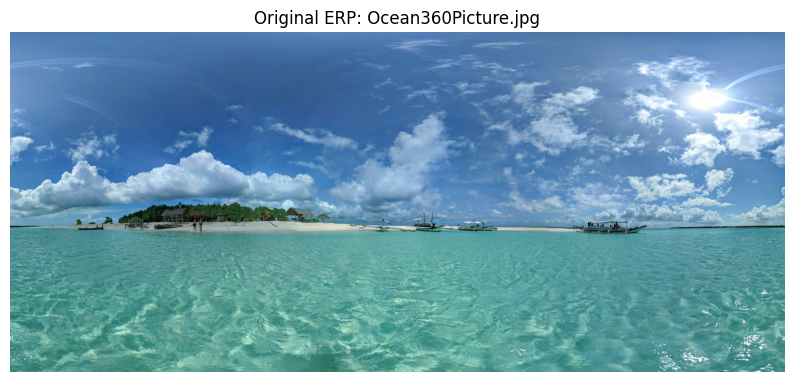

Tile width = 512, Tile height = 450
Reconstructed ERP shape: (4050, 9216, 3)


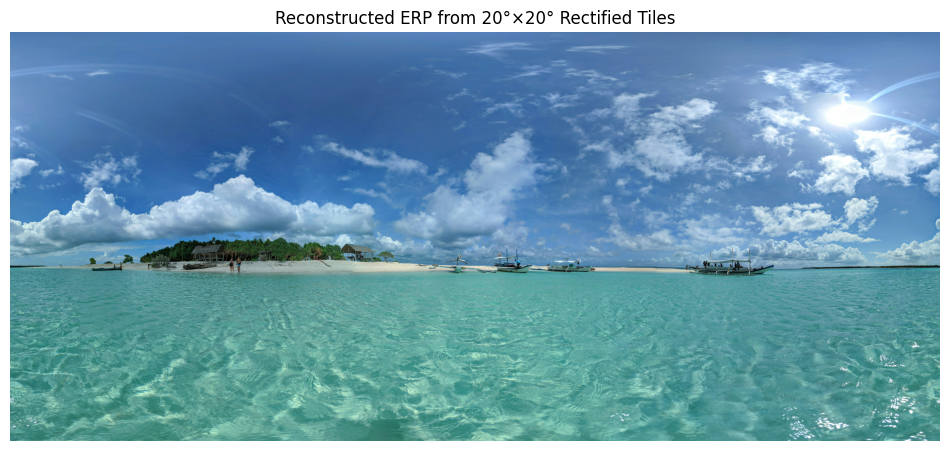

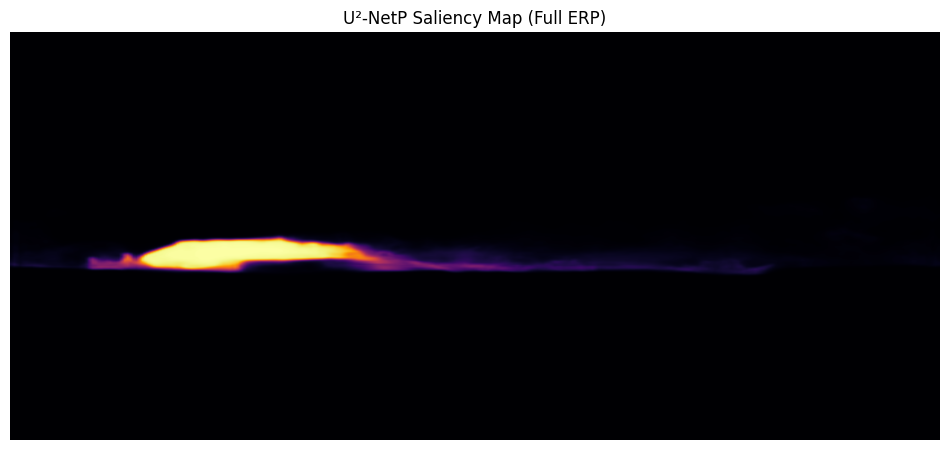


Processing: /content/Street360Picture.jpg
Height = 2048, Width = 4096


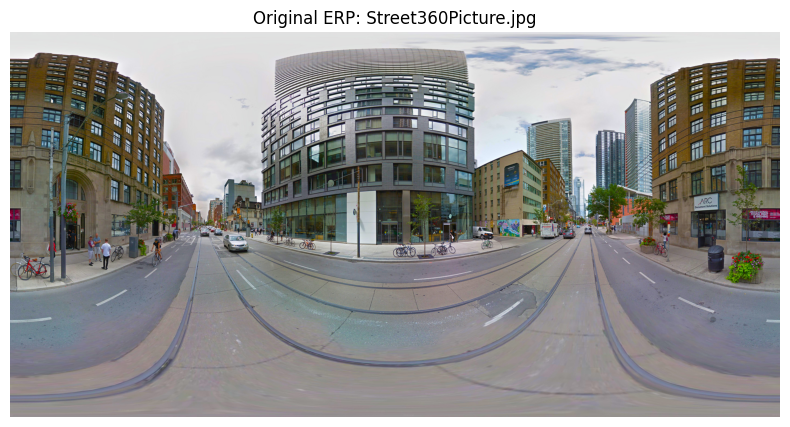

Tile width = 228, Tile height = 228
Reconstructed ERP shape: (2052, 4104, 3)


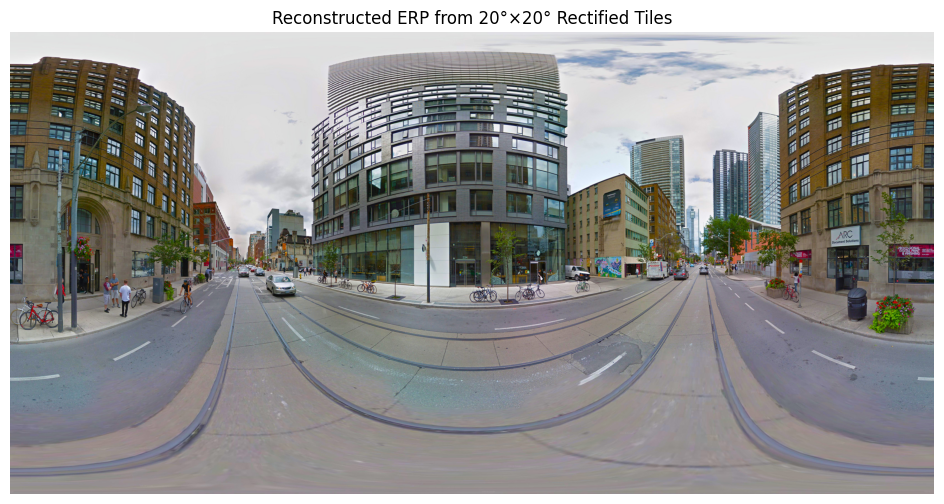

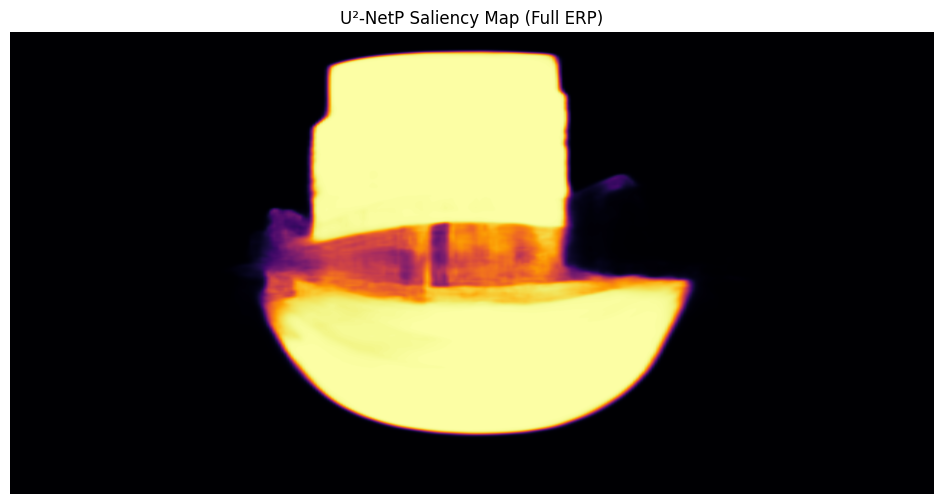


Processing: /content/chisinau.jpg
Height = 3721, Width = 10000


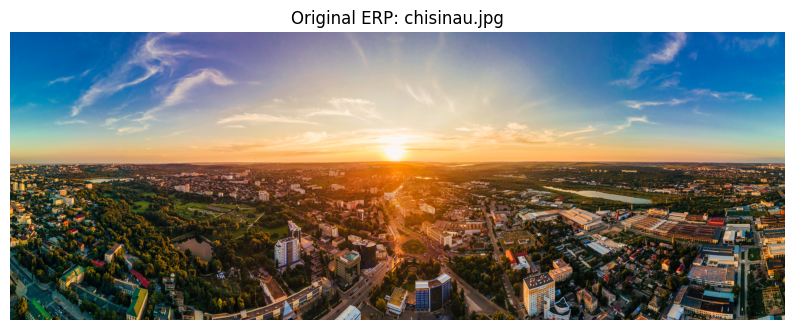

Tile width = 556, Tile height = 413
Reconstructed ERP shape: (3717, 10008, 3)


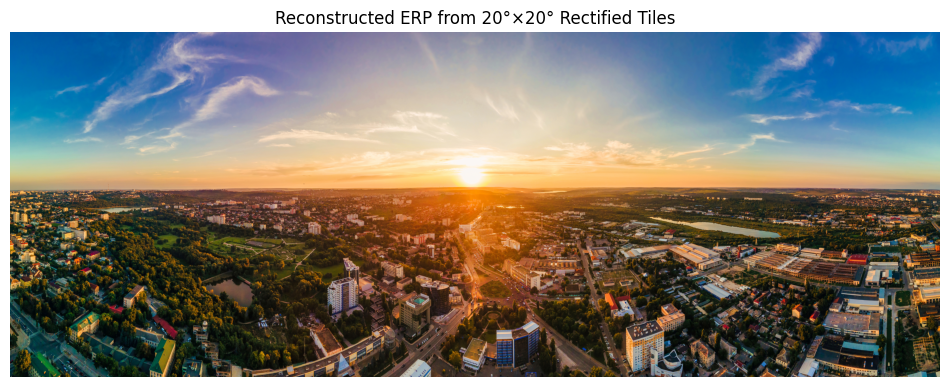

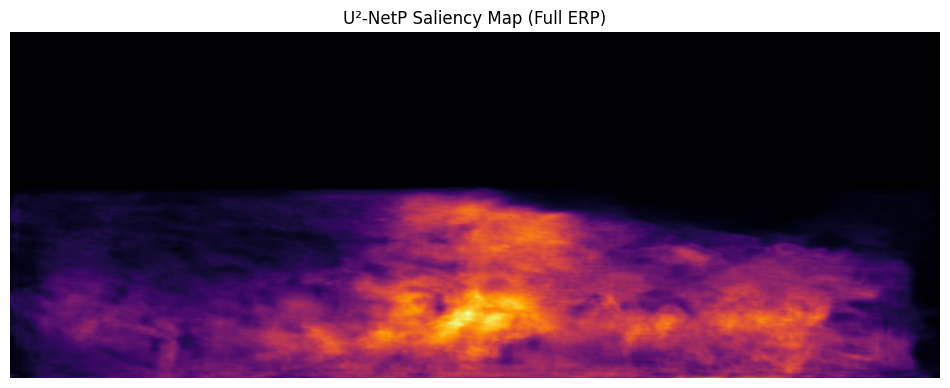


Processing: /content/manhattan.jpg
Height = 2425, Width = 6454


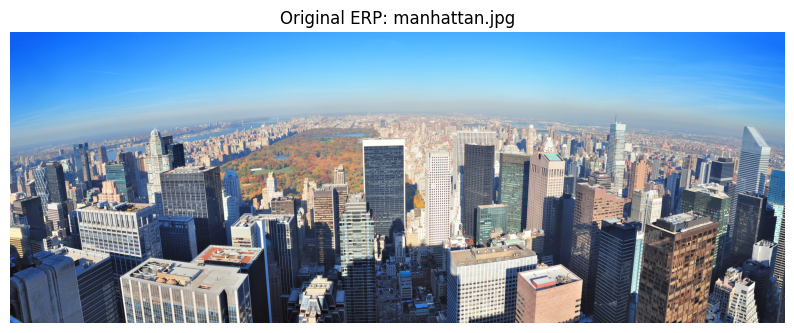

Tile width = 359, Tile height = 269
Reconstructed ERP shape: (2421, 6462, 3)


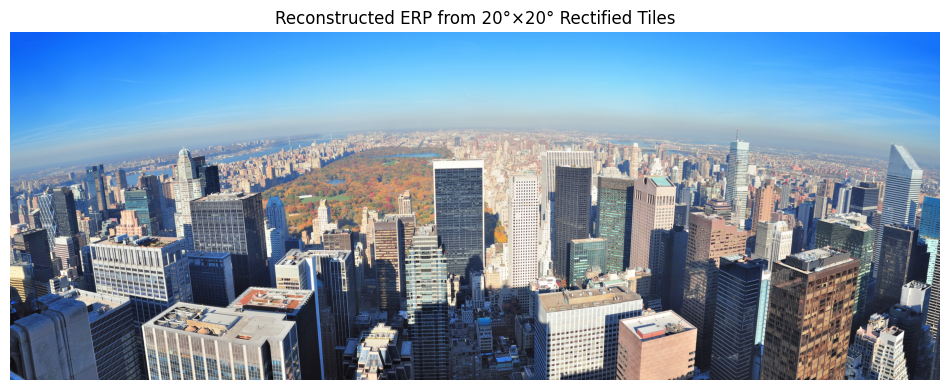

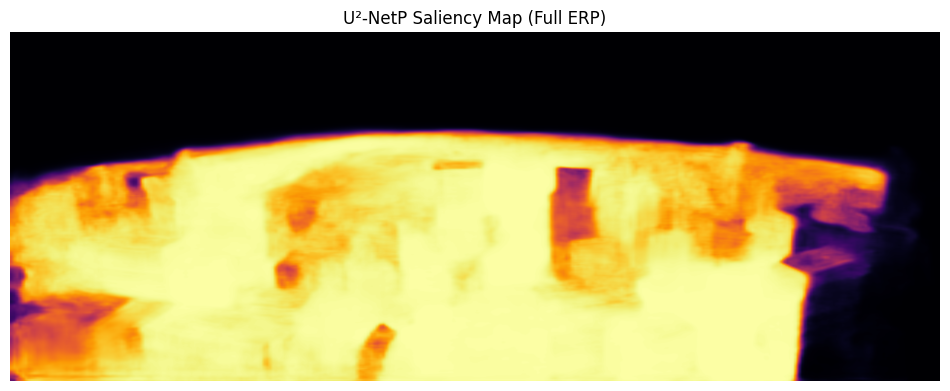


Processing: /content/moldova.jpg
Height = 3174, Width = 8192


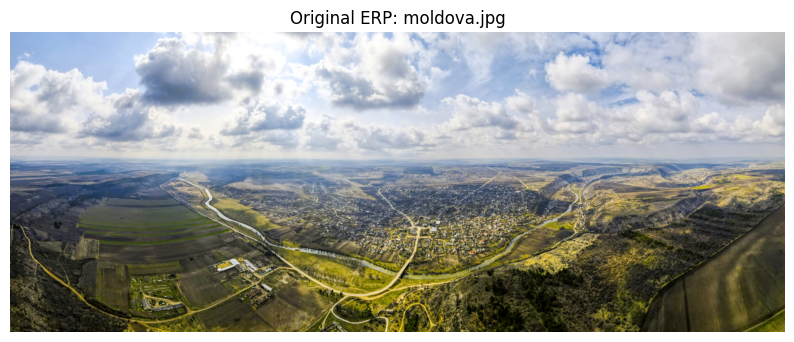

Tile width = 455, Tile height = 353
Reconstructed ERP shape: (3177, 8190, 3)


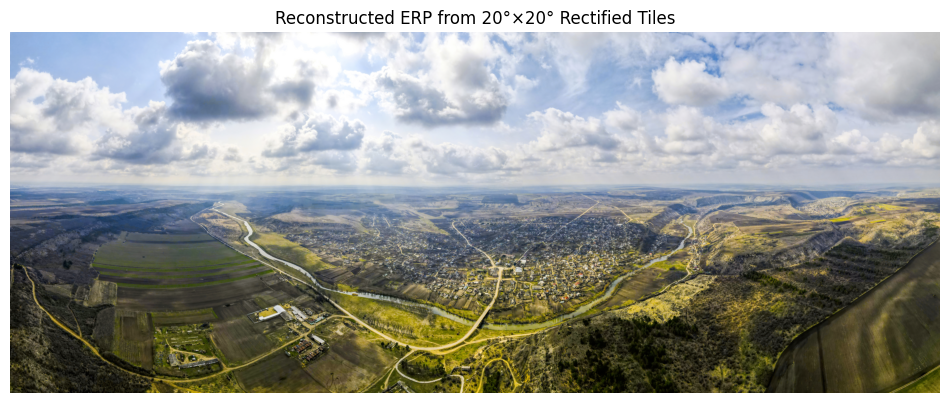

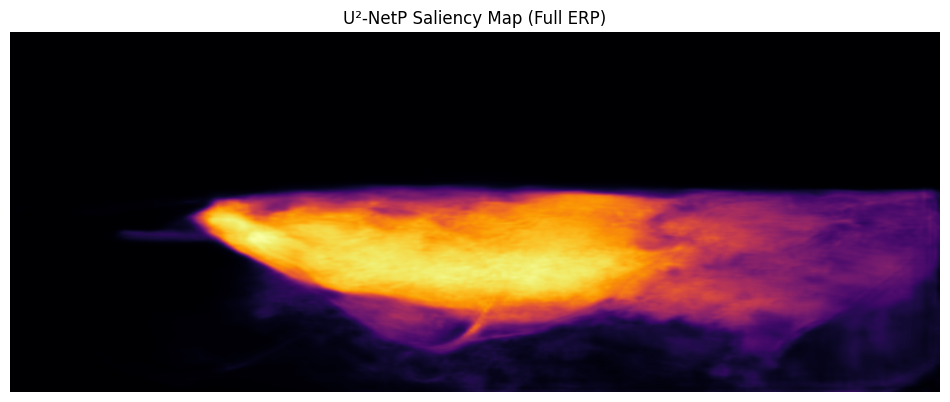

In [11]:
from IPython.display import Image as ColabImage
import matplotlib.pyplot as plt
import numpy as np
import cv2
import math
import torch
import torch.nn.functional as F
from torchvision import transforms
import os

# ============================================================
# STEP 0: Setup
# ============================================================

# Download weights with fallback to Hugging-Face source
MODEL_PATH = "/content/U-2-Net/u2netp.pth"
URL_HF     = "https://huggingface.co/netradrishti/u2net-saliency/resolve/main/models/u2netp.pth"

if not os.path.exists(MODEL_PATH):
    print("⬇ Trying download from Hugging Face …")
    result = os.system(f"wget {URL_HF} -O {MODEL_PATH}")
    if result != 0 or not os.path.exists(MODEL_PATH):
        raise FileNotFoundError("❌ Failed to download u2netp.pth from fallback source.")
    print("✔ Download succeeded from fallback source.")

# Then load model as before
u2netp = U2NETP(3, 1)
u2netp.load_state_dict(torch.load(MODEL_PATH, map_location="cpu"))
u2netp.eval()
print("✔ Model ready!")

transform_u2 = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((320, 320)),
    transforms.ToTensor()
])

# ============================================================
# STEP 1–4: Define Processing Function
# ============================================================

def process_image(filename):
    print("\n" + "="*60)
    print(f"Processing: {filename}")
    print("="*60)

    # STEP 1: Load ERP Image
    erp = cv2.imread(filename)
    if erp is None:
        print(f"⚠️ File not found: {filename}")
        return
    erp = cv2.cvtColor(erp, cv2.COLOR_BGR2RGB)
    H, W, _ = erp.shape
    print(f"Height = {H}, Width = {W}")

    plt.figure(figsize=(10, 5))
    plt.imshow(erp)
    plt.title(f"Original ERP: {os.path.basename(filename)}")
    plt.axis("off")
    plt.show()

    # STEP 2: Rectified Tiling (20°×20°)
    widthDegree, heightDegree = 20, 20
    num_lon_tiles = int(360 / widthDegree)
    num_lat_tiles = int(180 / heightDegree)

    tileWidth = int(round(W / num_lon_tiles))
    tileHeight = int(round(H / num_lat_tiles))
    print(f"Tile width = {tileWidth}, Tile height = {tileHeight}")

    finalTiles = [[None for _ in range(num_lon_tiles)] for _ in range(num_lat_tiles)]

    for lat_i in range(num_lat_tiles):
        lat_max = 90.0 - lat_i * heightDegree
        lat_min = lat_max - heightDegree
        lat_vals = np.linspace(lat_max, lat_min, tileHeight)
        for lon_j in range(num_lon_tiles):
            lon_min = lon_j * widthDegree - 180.0
            lon_max = lon_min + widthDegree
            lon_vals = np.linspace(lon_min, lon_max, tileWidth)

            erp_x_vec = (lon_vals + 180.0) / 360.0 * (W - 1)
            erp_y_vec = (90.0 - lat_vals) / 180.0 * (H - 1)

            map_x = np.tile(erp_x_vec, (tileHeight, 1)).astype(np.float32)
            map_y = np.repeat(erp_y_vec[:, np.newaxis], tileWidth, axis=1).astype(np.float32)

            tile_img = cv2.remap(erp, map_x, map_y, interpolation=cv2.INTER_LINEAR, borderMode=cv2.BORDER_WRAP)
            finalTiles[lat_i][lon_j] = tile_img

    # STEP 3: Reconstruct ERP from Rectified Tiles
    erp_reconstructed = np.vstack([np.hstack(row) for row in finalTiles])
    print("Reconstructed ERP shape:", erp_reconstructed.shape)

    plt.figure(figsize=(12, 6))
    plt.imshow(erp_reconstructed)
    plt.title("Reconstructed ERP from 20°×20° Rectified Tiles")
    plt.axis("off")
    plt.show()

    # STEP 4: Run U²-NetP (Global)
    input_full = transform_u2(erp_reconstructed).unsqueeze(0)
    with torch.no_grad():
        d1, *_ = u2netp(input_full)
        pred_full = F.interpolate(d1, size=(H, W), mode="bilinear", align_corners=False)
        saliency_full = pred_full.squeeze().cpu().numpy()

    saliency_full_resized = (saliency_full - saliency_full.min()) / (saliency_full.max() - saliency_full.min() + 1e-8)

    plt.figure(figsize=(12, 6))
    plt.imshow(saliency_full_resized, cmap="inferno")
    plt.title("U²-NetP Saliency Map (Full ERP)")
    plt.axis("off")
    plt.show()

    return saliency_full_resized

# ============================================================
# STEP 5: Run for All Files
# ============================================================

file_list = [
    "/content/Ocean360Picture.jpg", "/content/Street360Picture.jpg",
    "/content/chisinau.jpg", "/content/manhattan.jpg",
    "/content/moldova.jpg"
]

for f in file_list:
    process_image(f)

Trying to Implement the above code to a 360 video

✔ Frames extracted to: /content/frames
Total frames: 25
First 5 frames: ['/content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0001.jpg', '/content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0002.jpg', '/content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0003.jpg', '/content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0004.jpg', '/content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0005.jpg']

=== Processing frame 1/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0001.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0001.jpg
Height = 2048, Width = 3840


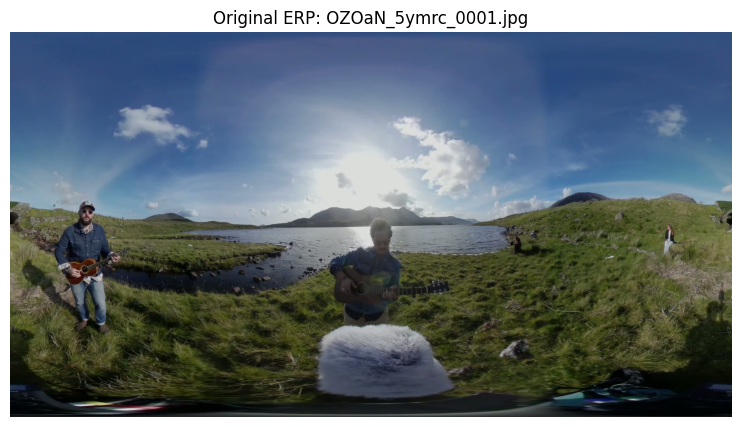

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


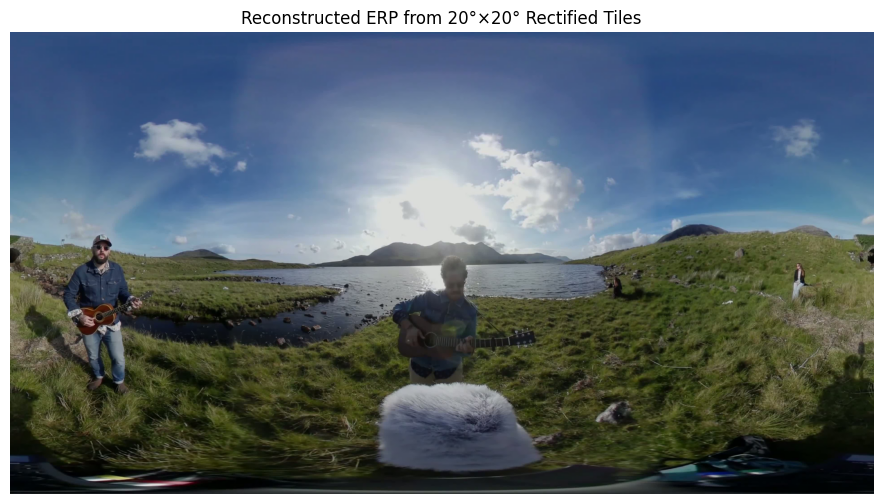

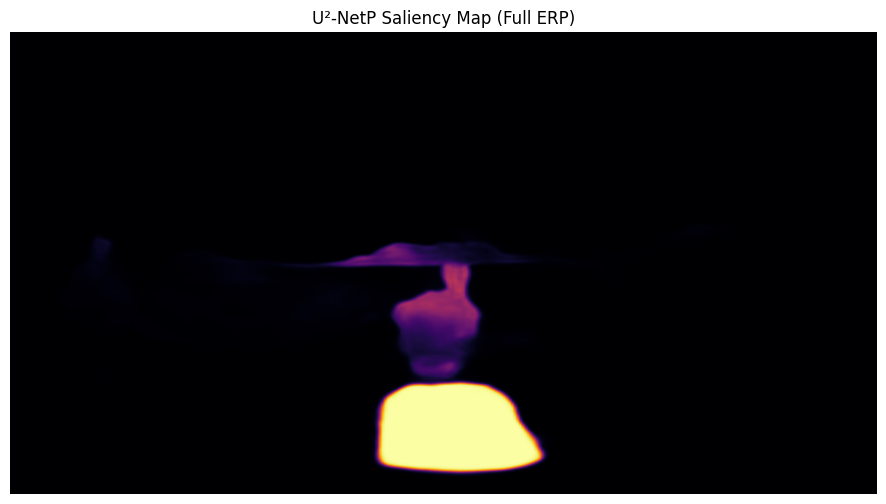


=== Processing frame 2/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0002.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0002.jpg
Height = 2048, Width = 3840


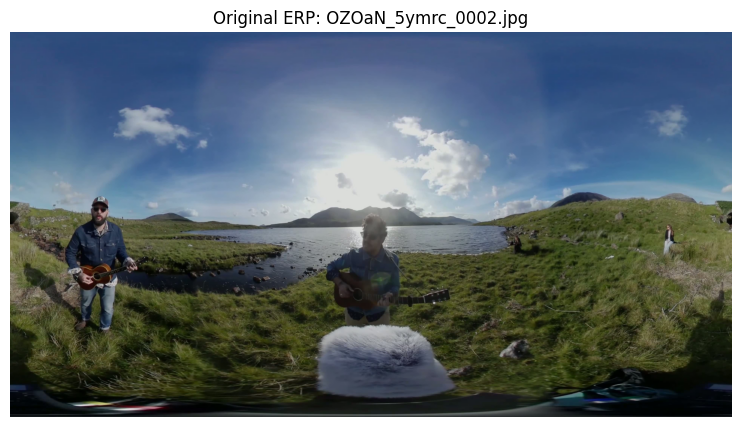

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


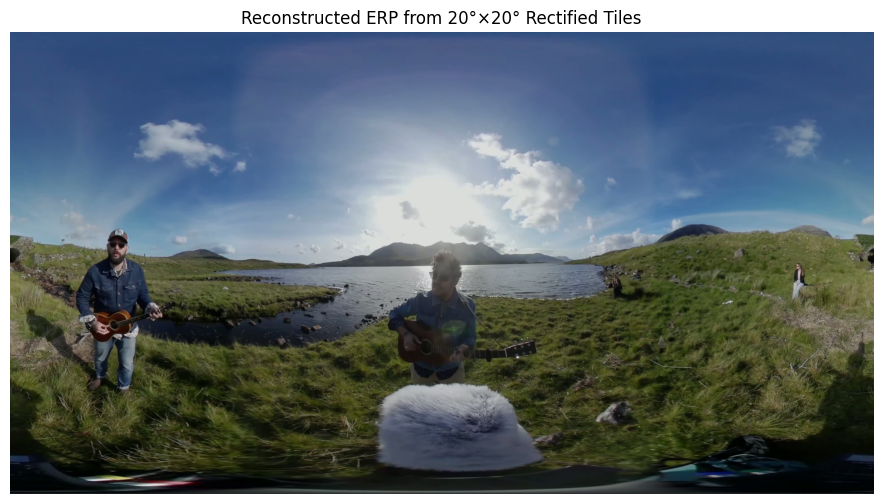

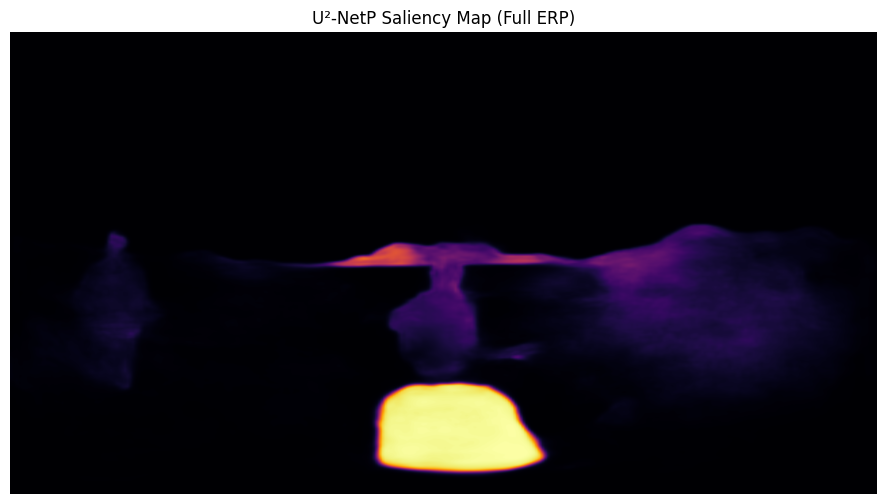


=== Processing frame 3/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0003.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0003.jpg
Height = 2048, Width = 3840


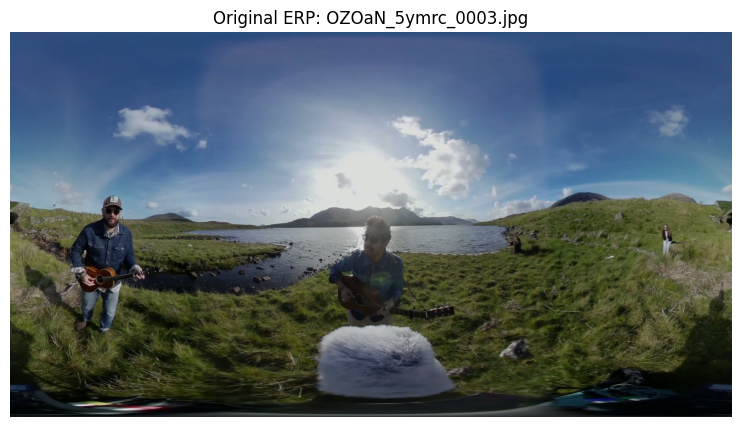

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


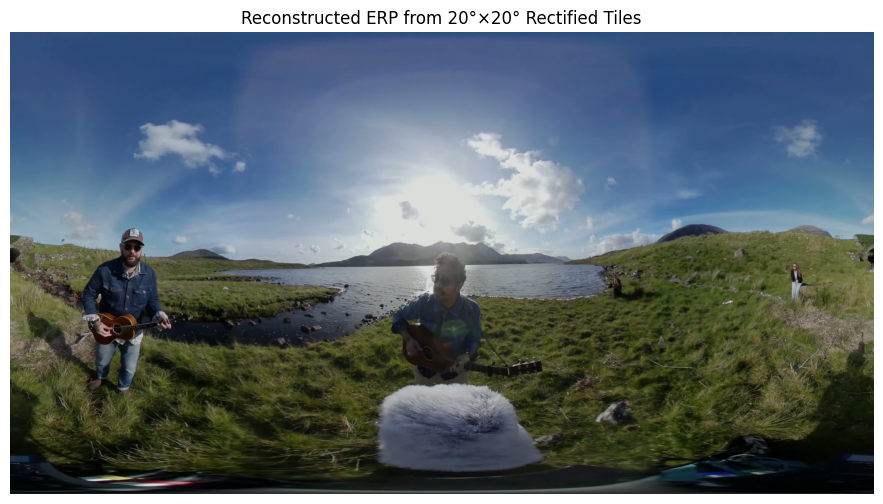

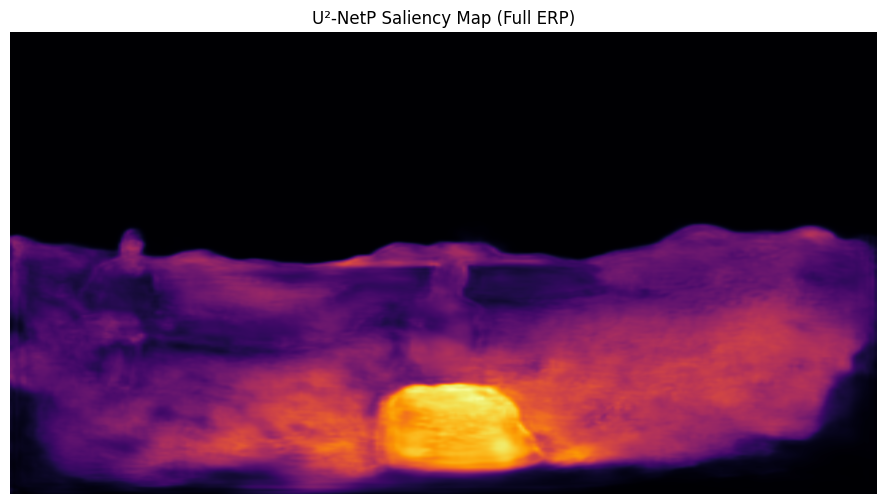


=== Processing frame 4/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0004.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0004.jpg
Height = 2048, Width = 3840


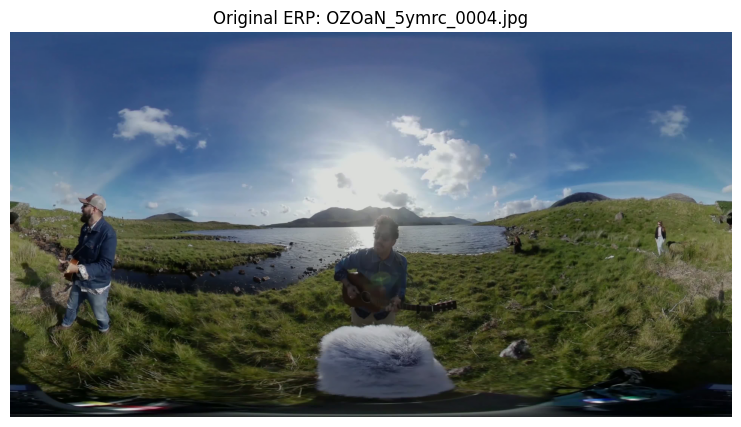

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


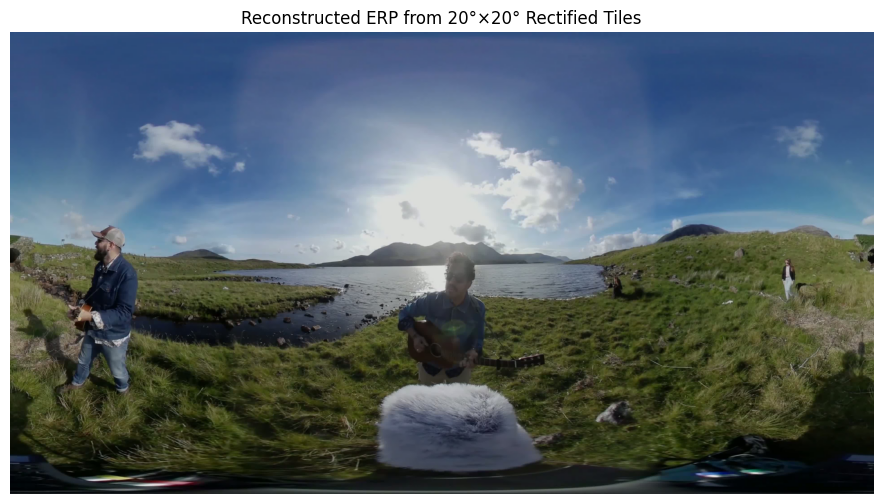

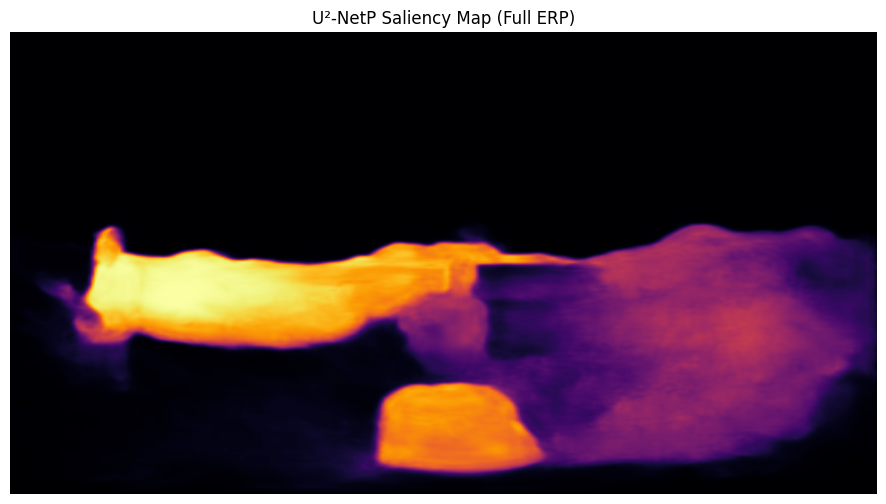


=== Processing frame 5/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0005.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0005.jpg
Height = 2048, Width = 3840


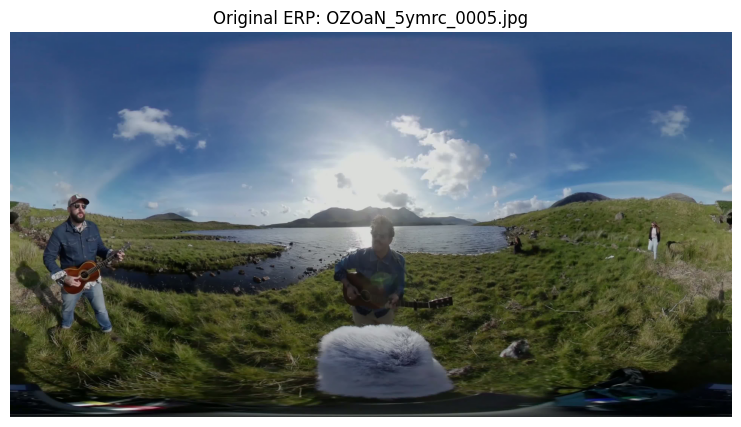

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


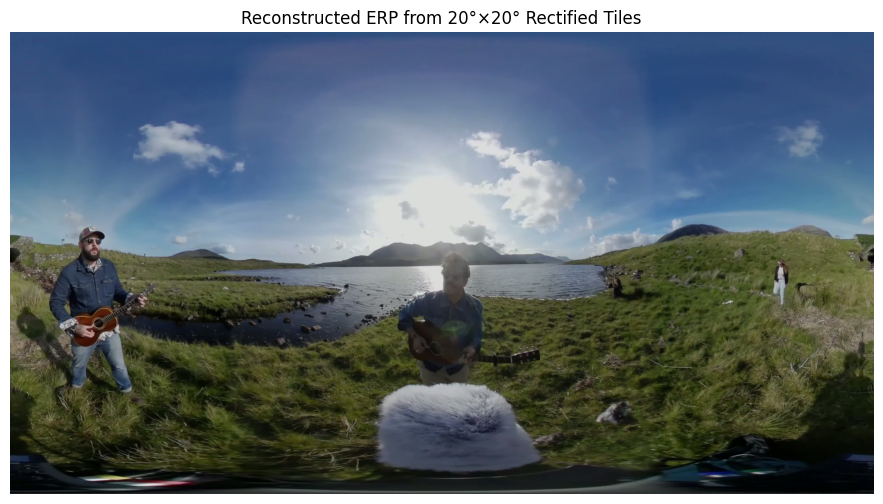

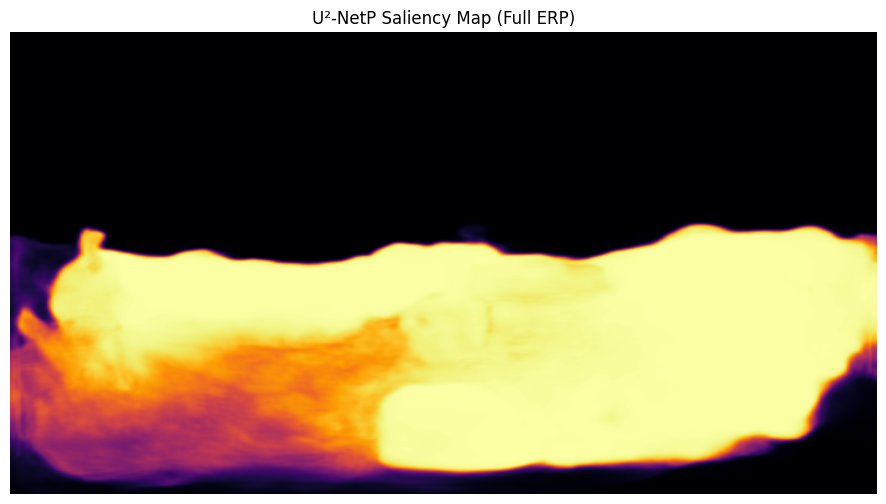


=== Processing frame 6/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0006.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0006.jpg
Height = 2048, Width = 3840


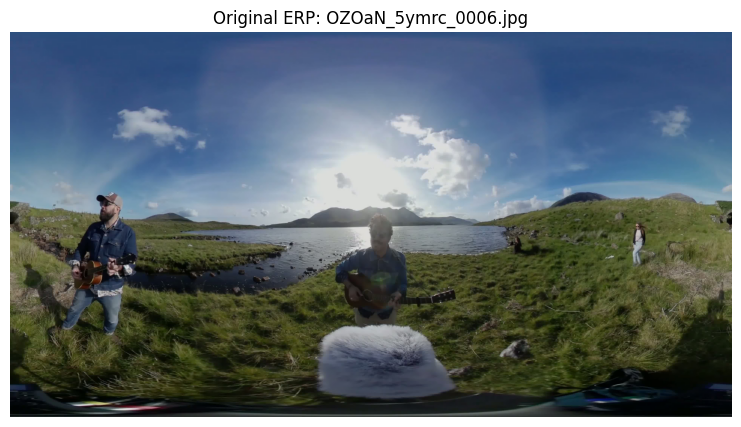

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


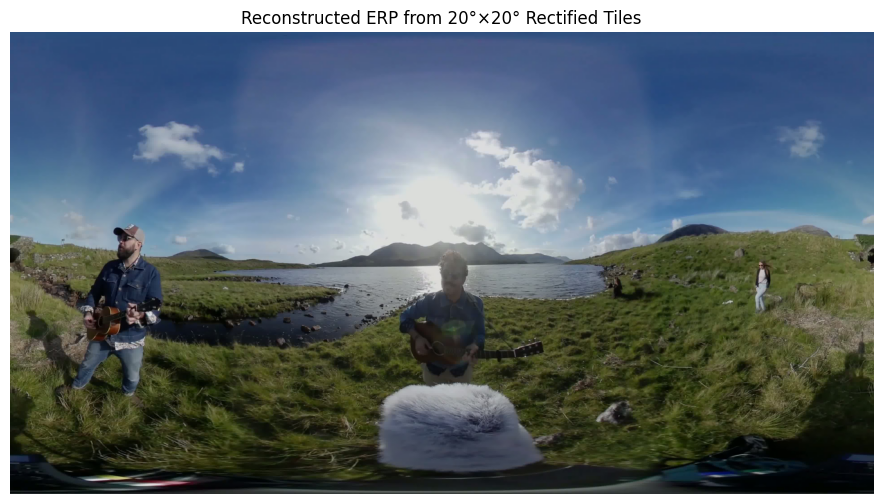

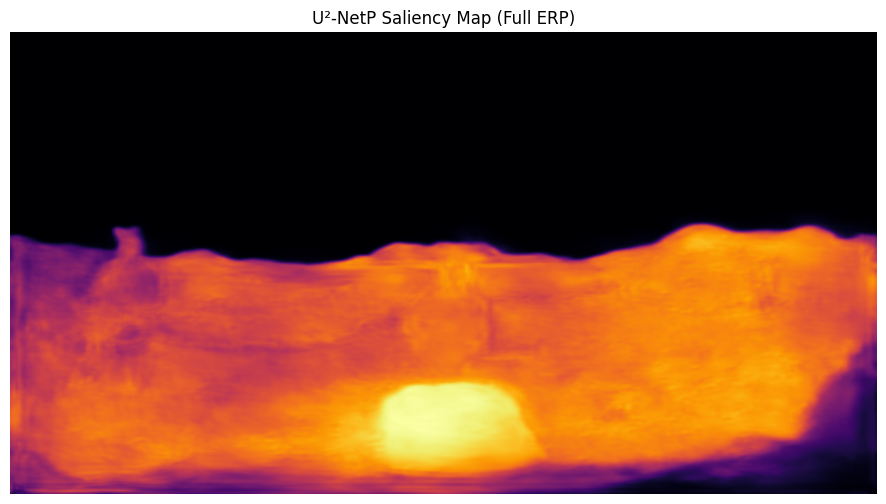


=== Processing frame 7/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0007.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0007.jpg
Height = 2048, Width = 3840


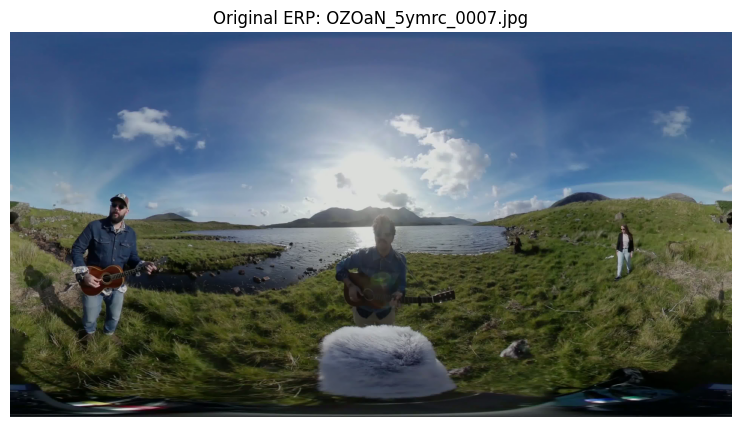

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


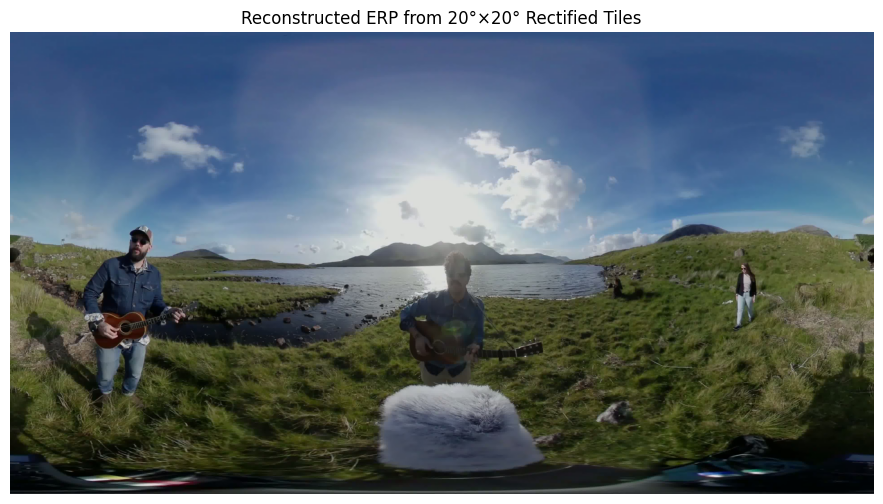

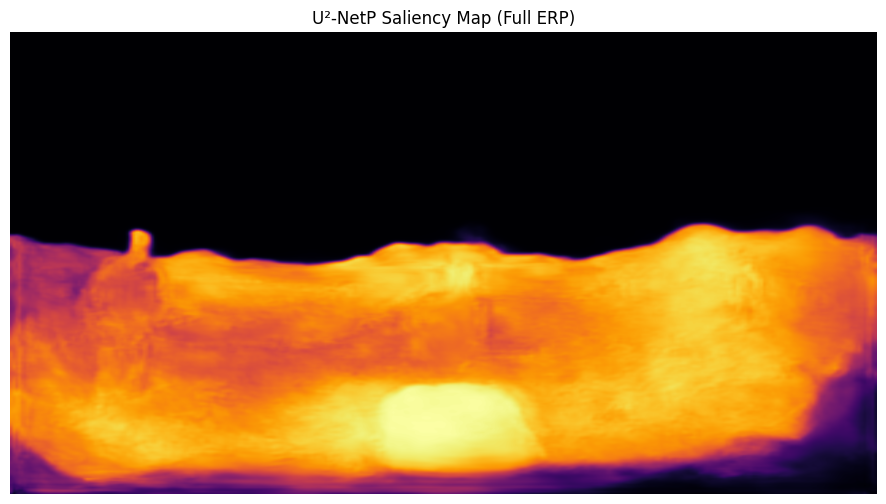


=== Processing frame 8/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0008.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0008.jpg
Height = 2048, Width = 3840


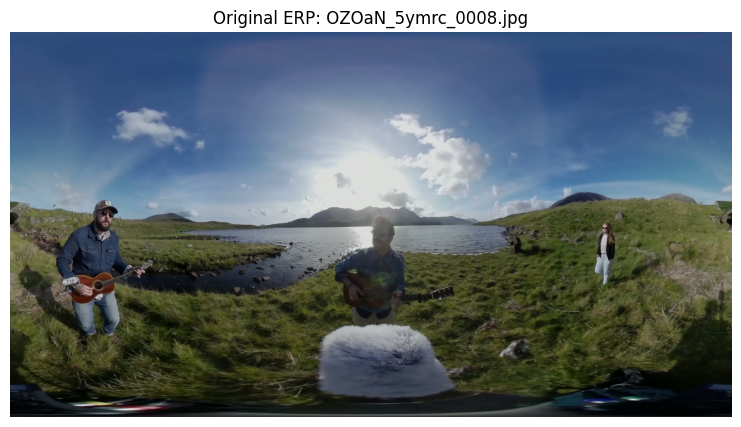

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


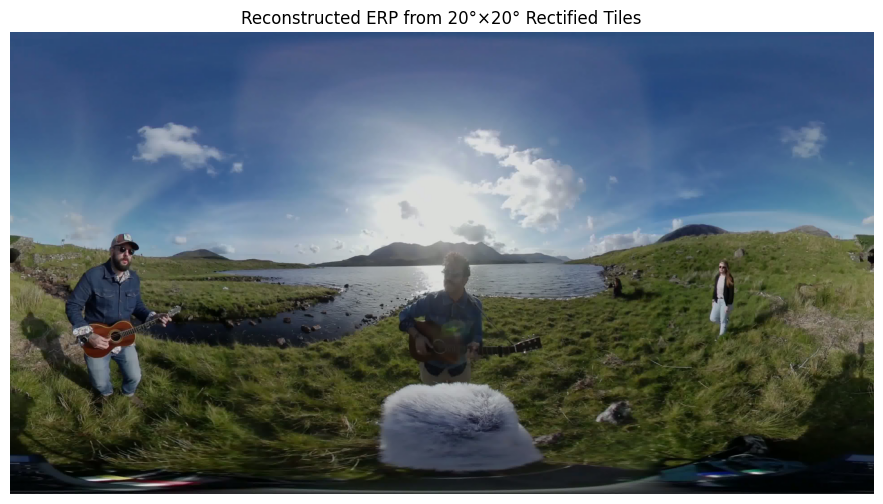

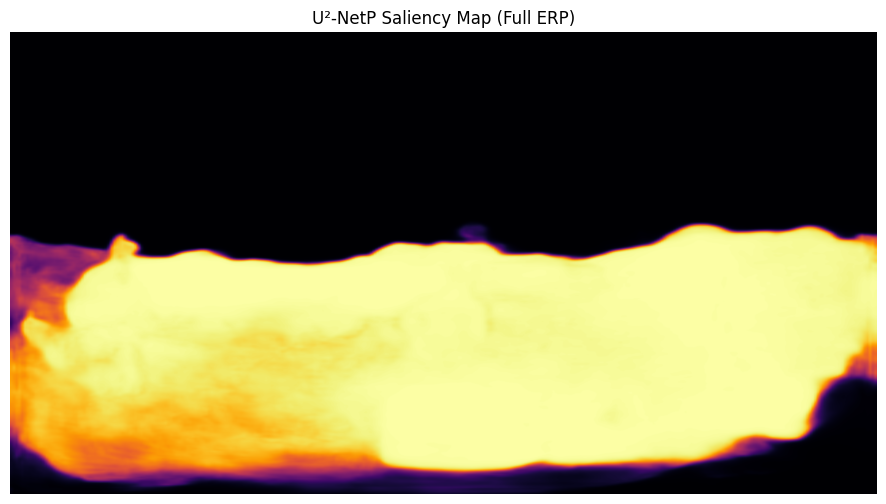


=== Processing frame 9/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0009.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0009.jpg
Height = 2048, Width = 3840


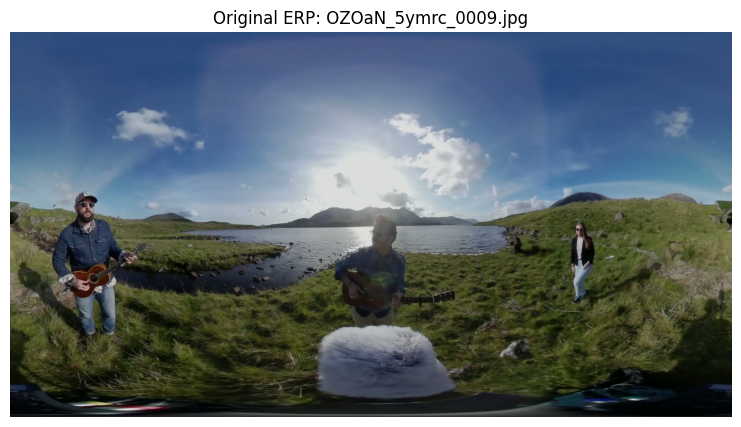

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


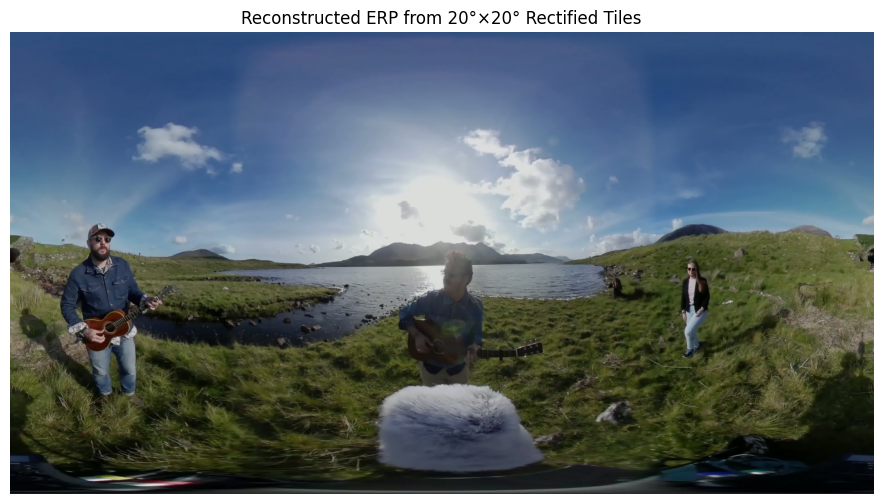

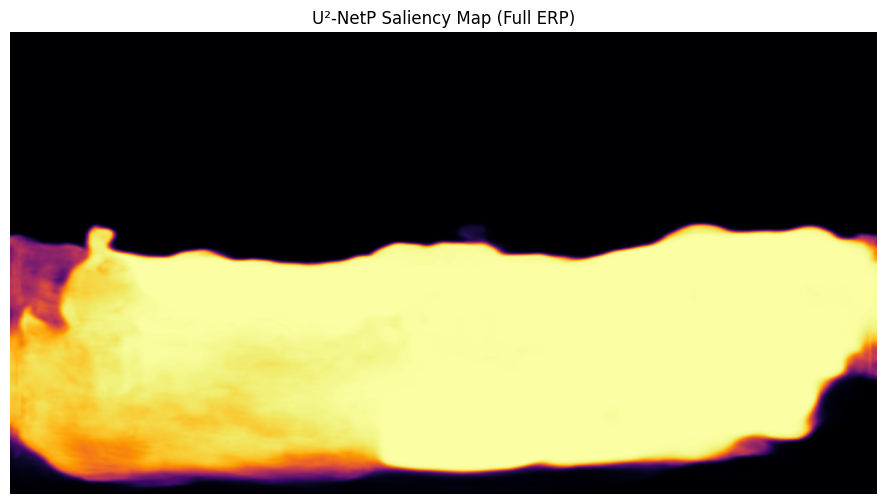


=== Processing frame 10/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0010.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0010.jpg
Height = 2048, Width = 3840


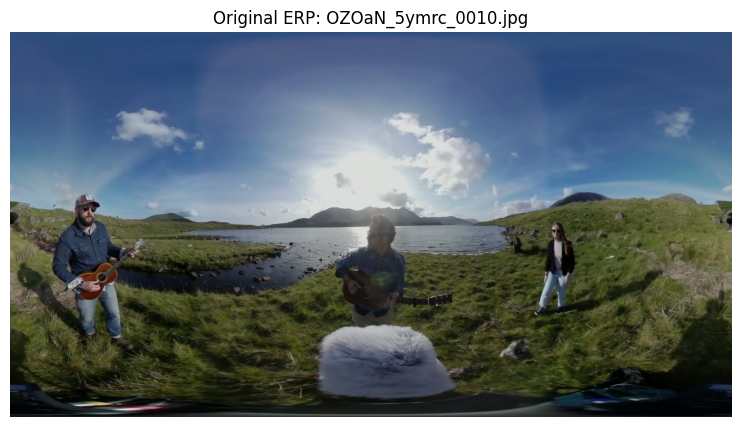

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


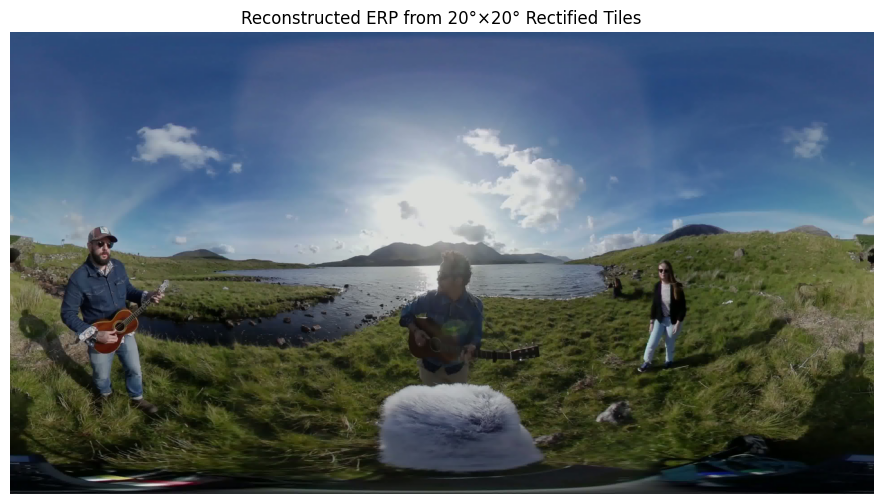

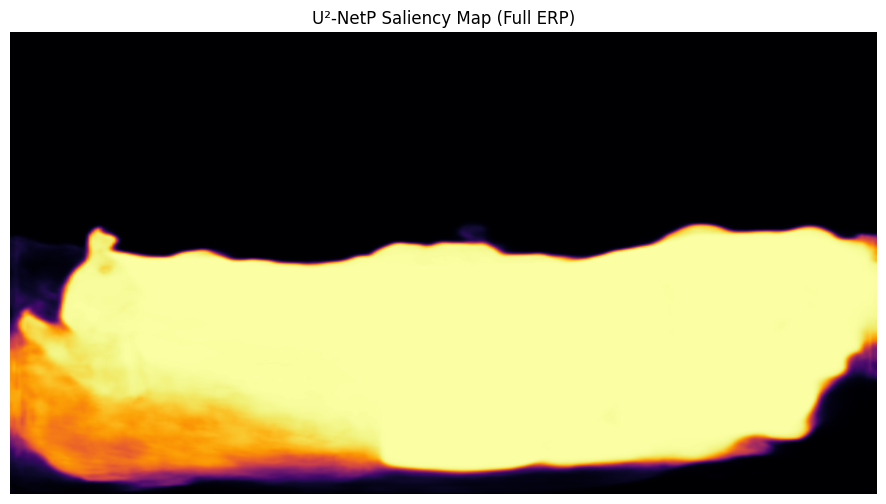


=== Processing frame 11/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0011.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0011.jpg
Height = 2048, Width = 3840


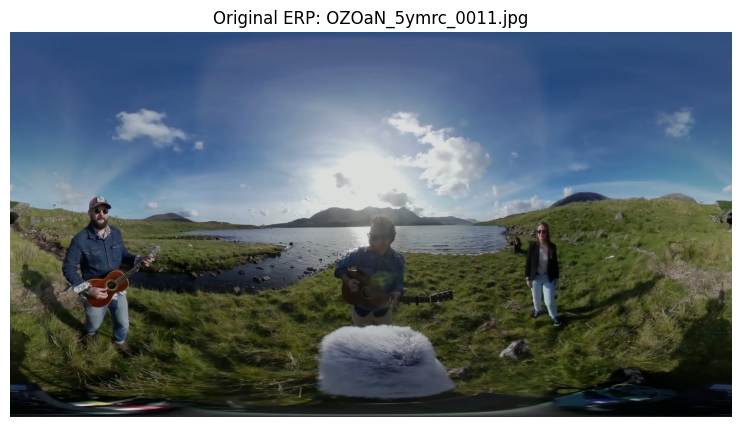

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


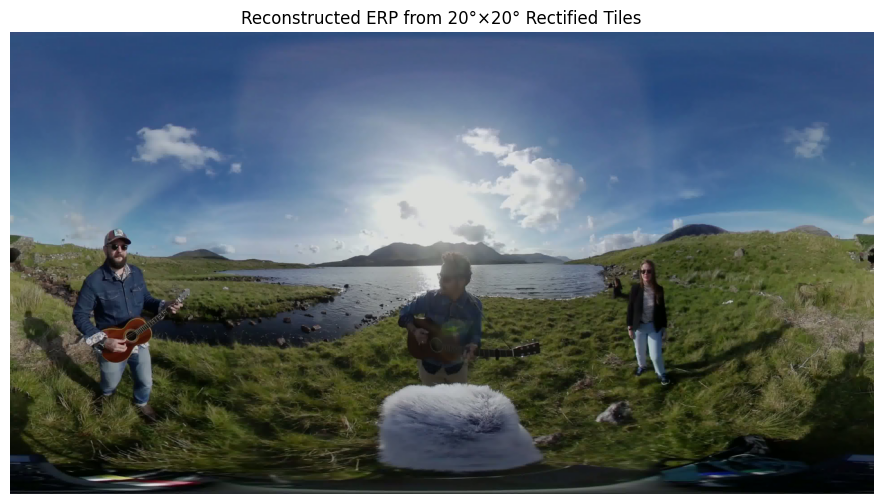

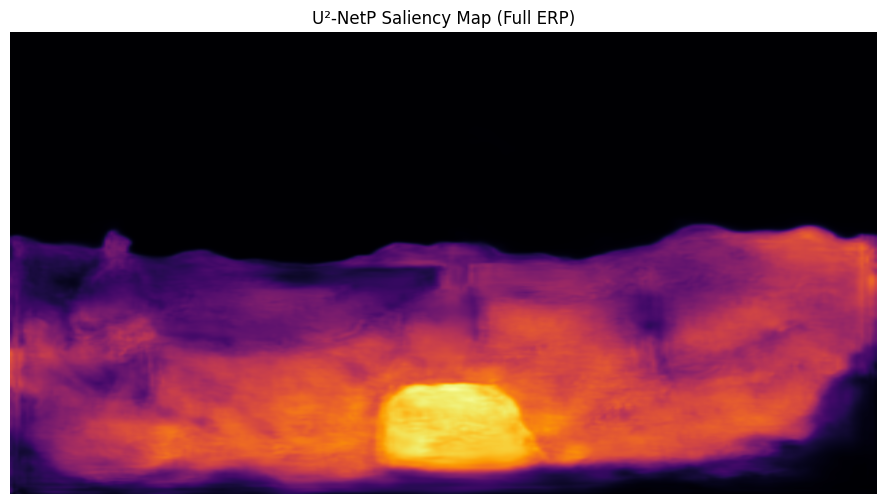


=== Processing frame 12/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0012.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0012.jpg
Height = 2048, Width = 3840


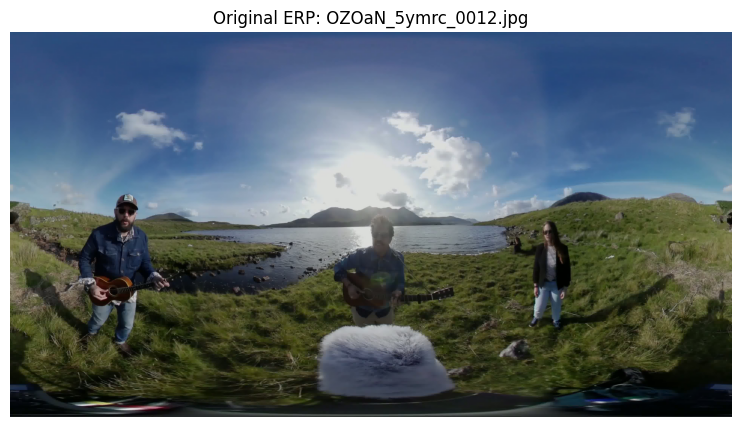

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


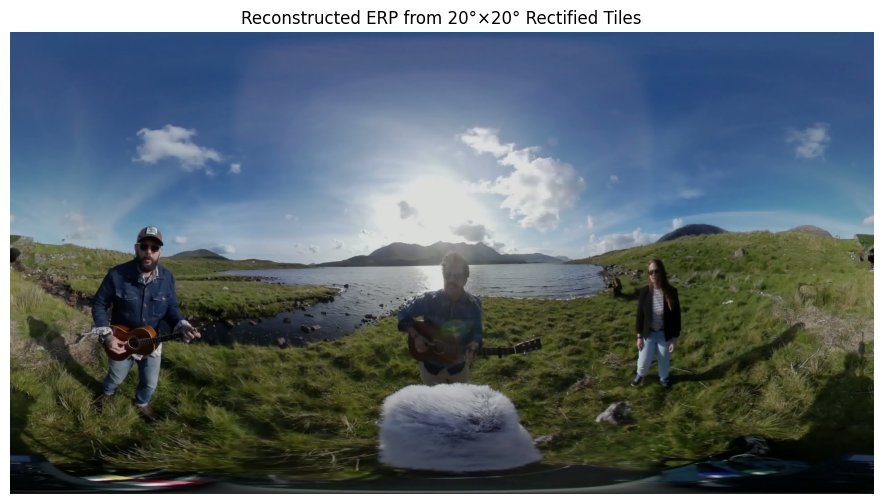

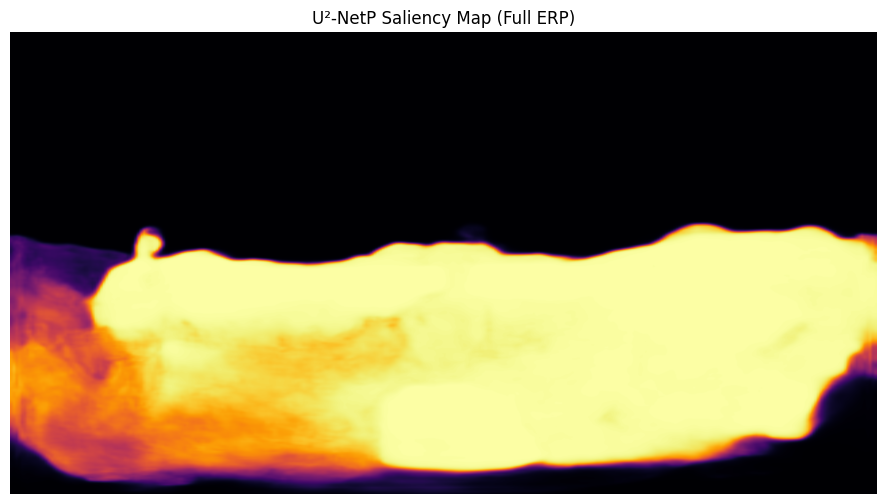


=== Processing frame 13/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0013.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0013.jpg
Height = 2048, Width = 3840


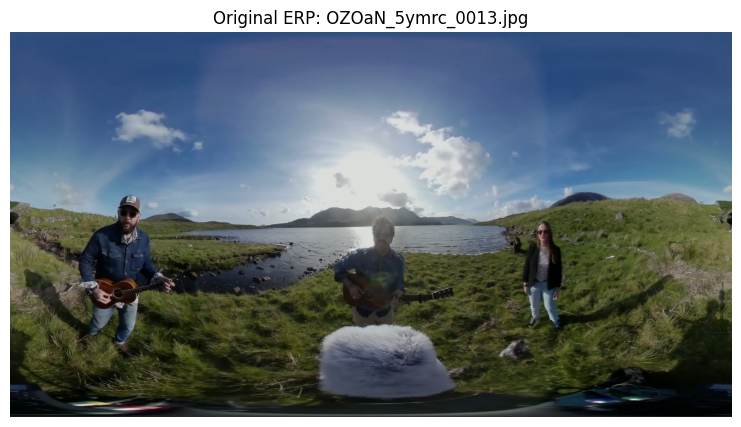

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


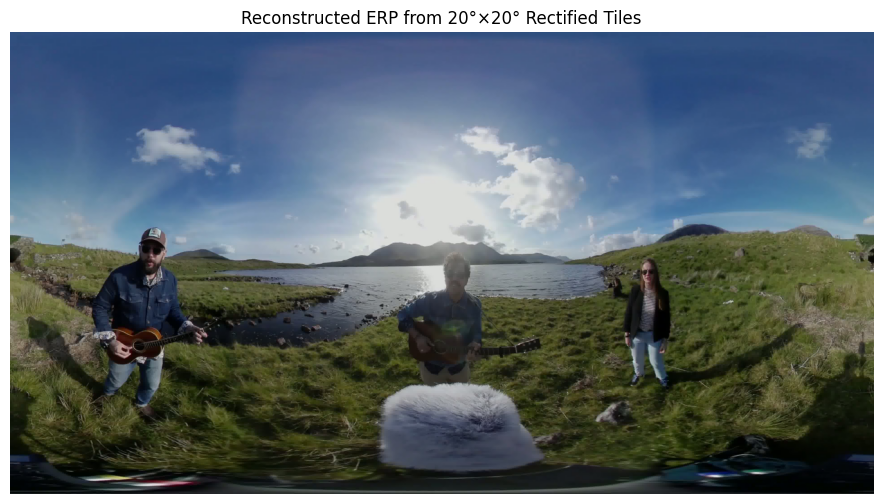

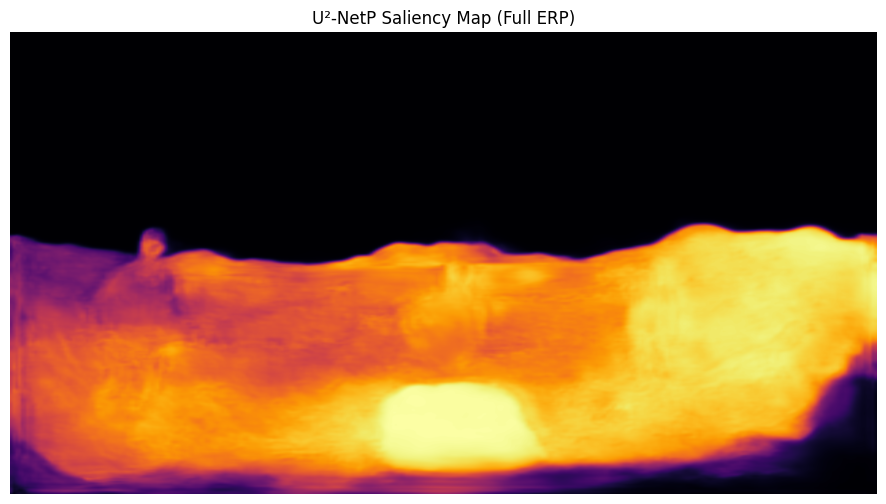


=== Processing frame 14/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0014.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0014.jpg
Height = 2048, Width = 3840


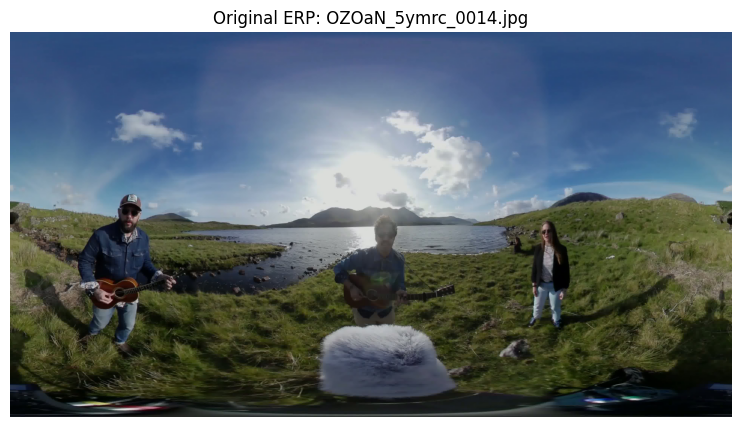

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


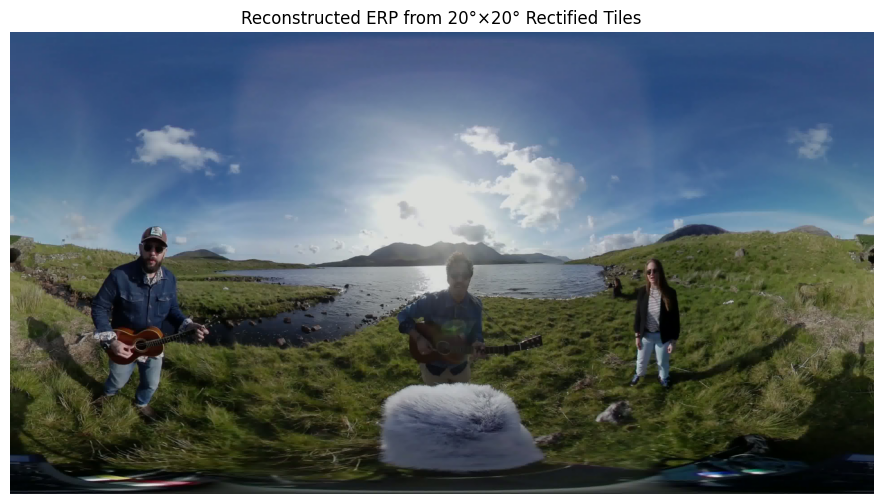

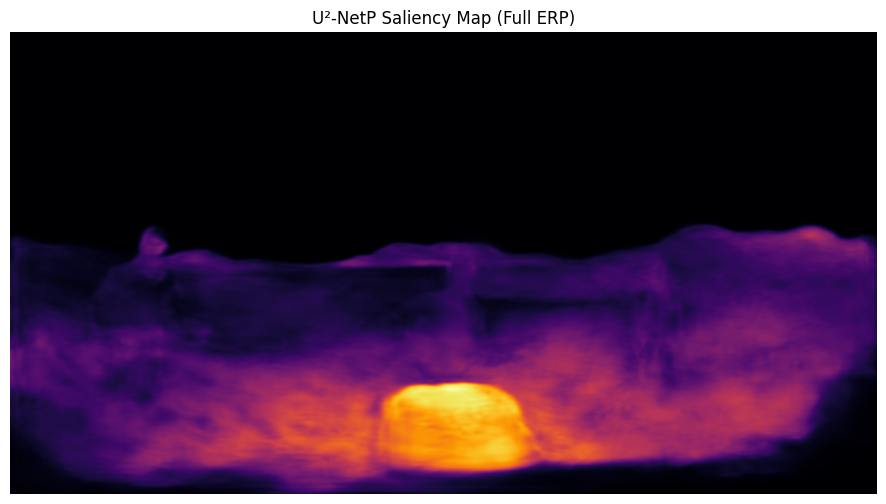


=== Processing frame 15/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0015.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0015.jpg
Height = 2048, Width = 3840


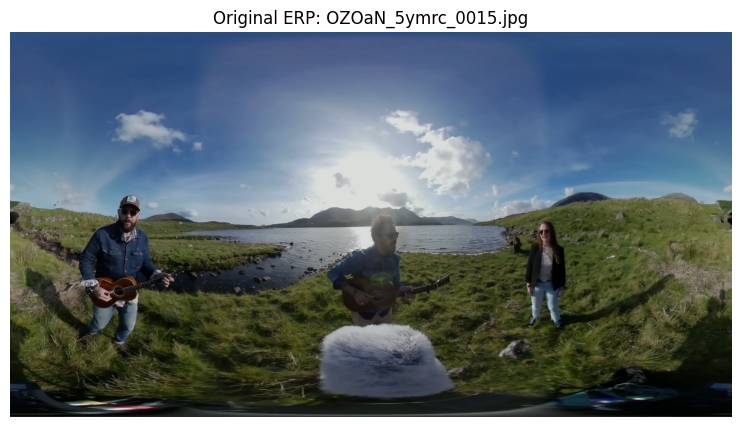

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


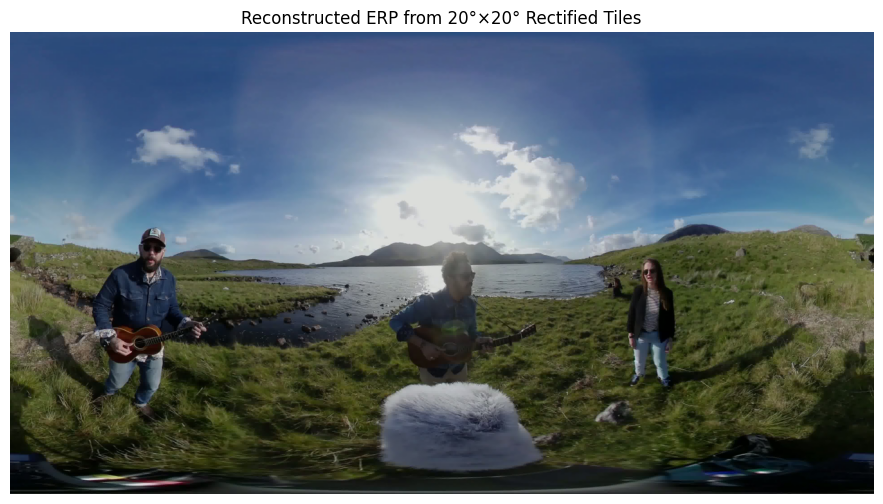

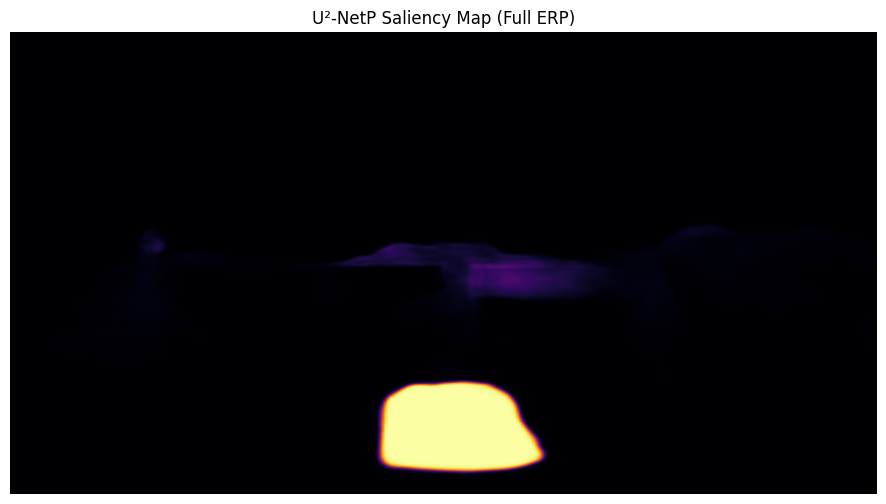


=== Processing frame 16/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0016.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0016.jpg
Height = 2048, Width = 3840


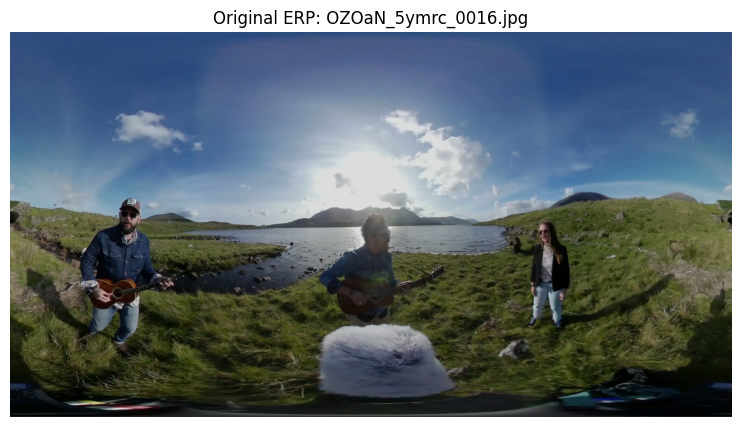

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


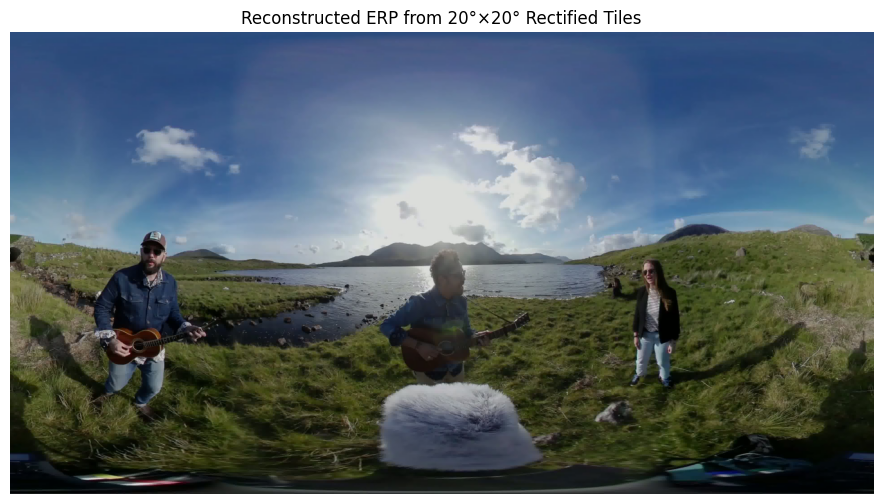

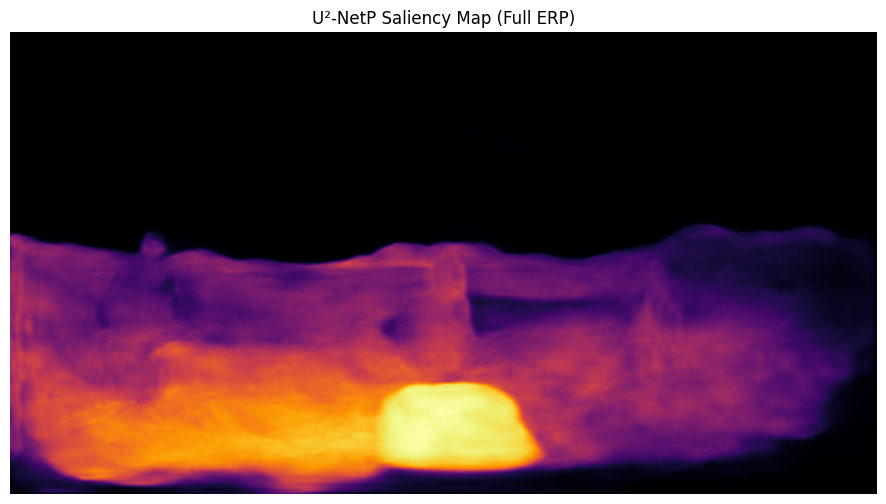


=== Processing frame 17/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0017.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0017.jpg
Height = 2048, Width = 3840


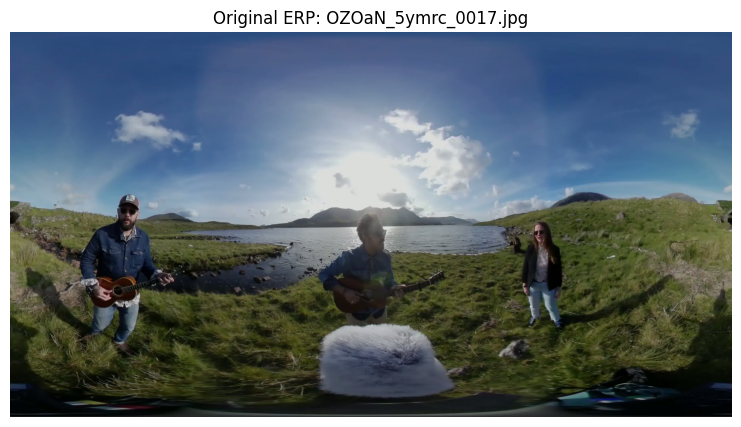

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


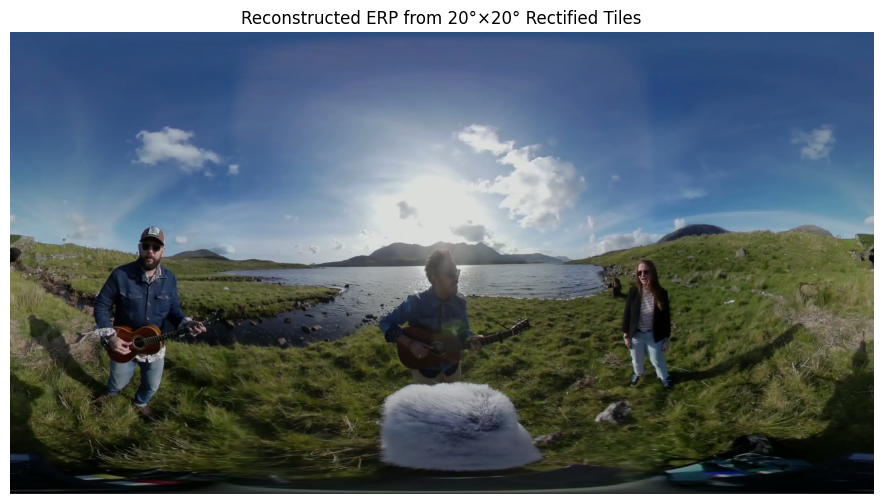

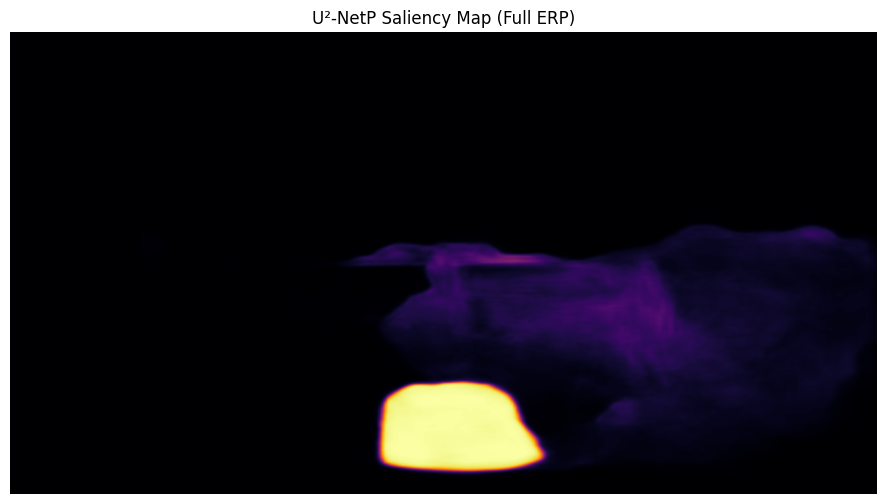


=== Processing frame 18/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0018.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0018.jpg
Height = 2048, Width = 3840


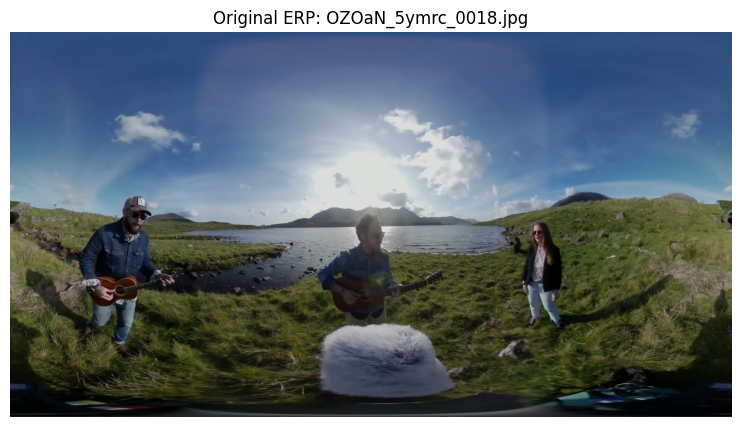

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


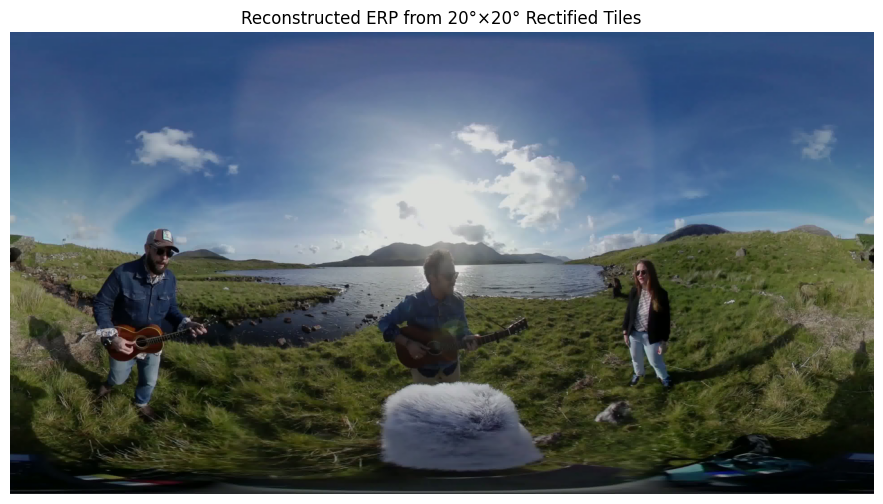

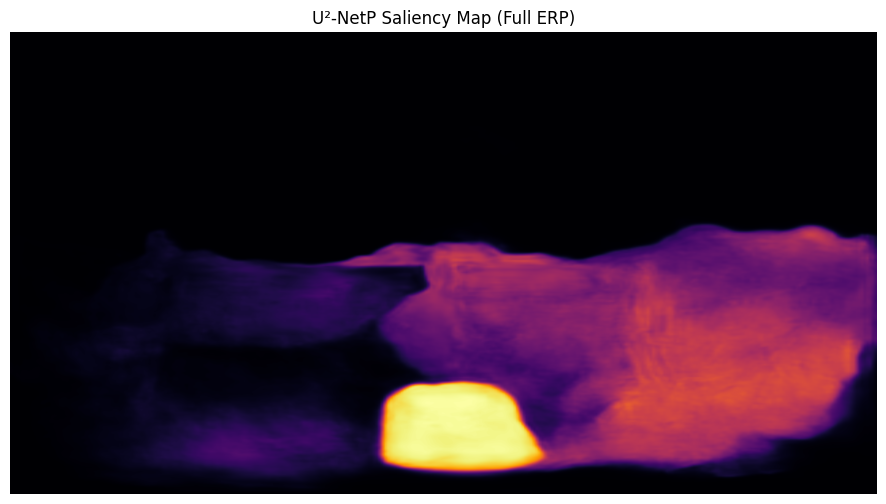


=== Processing frame 19/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0019.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0019.jpg
Height = 2048, Width = 3840


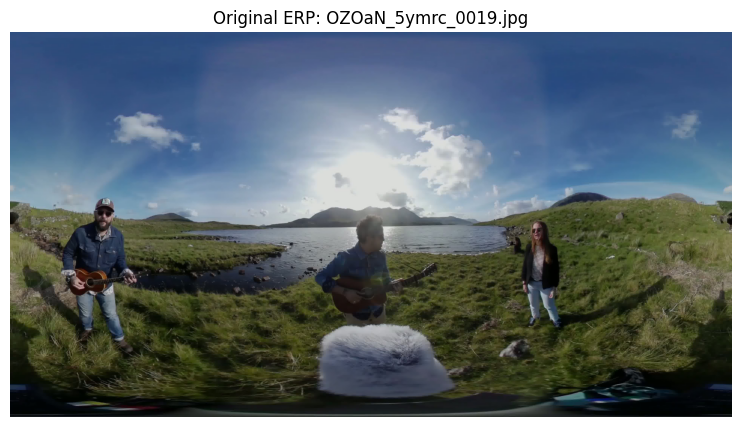

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


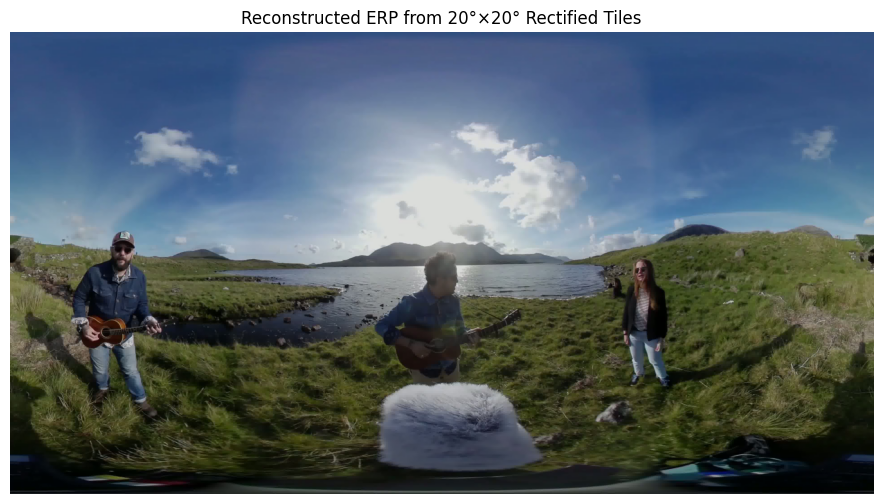

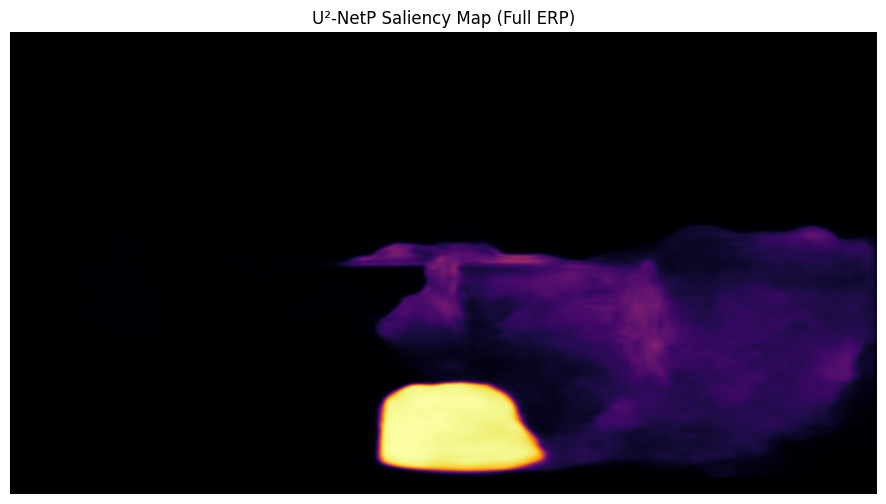


=== Processing frame 20/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0020.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0020.jpg
Height = 2048, Width = 3840


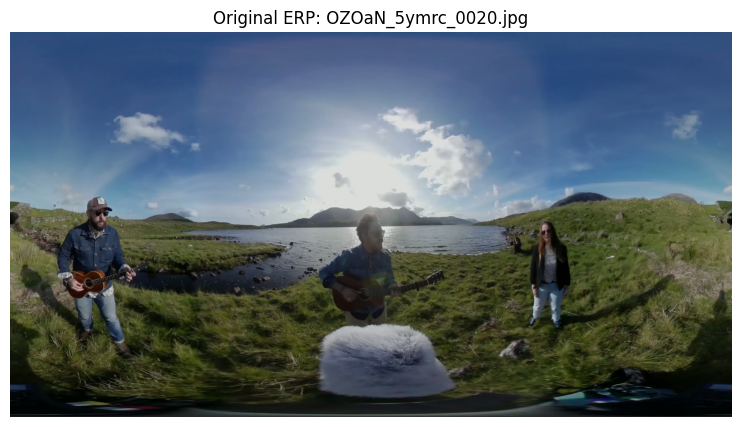

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


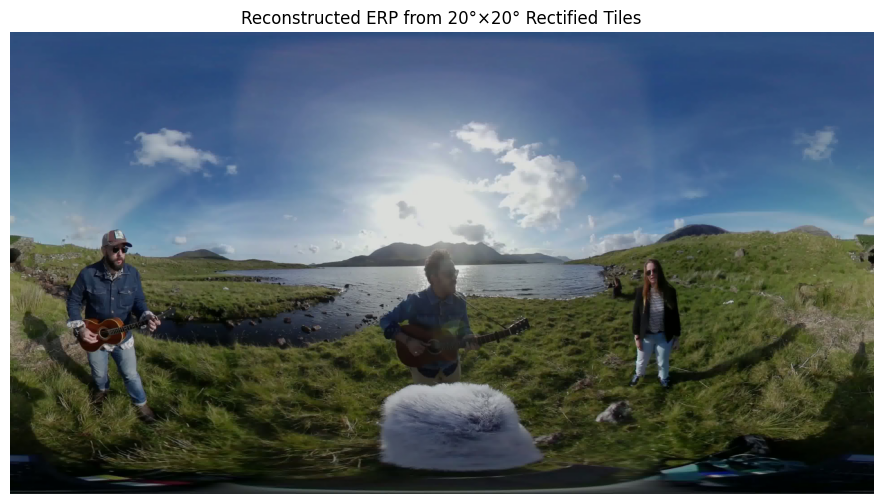

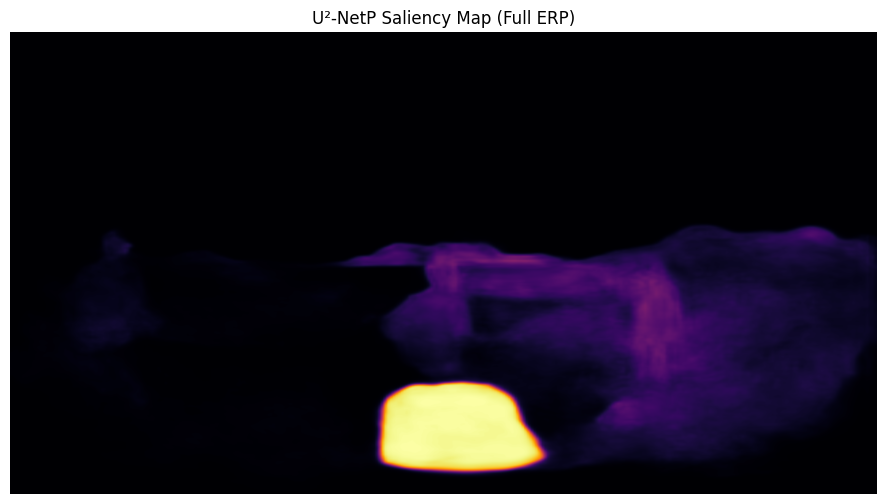


=== Processing frame 21/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0021.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0021.jpg
Height = 2048, Width = 3840


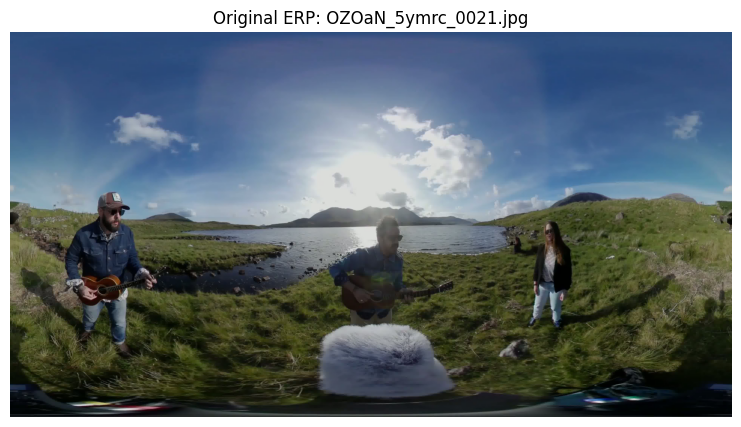

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


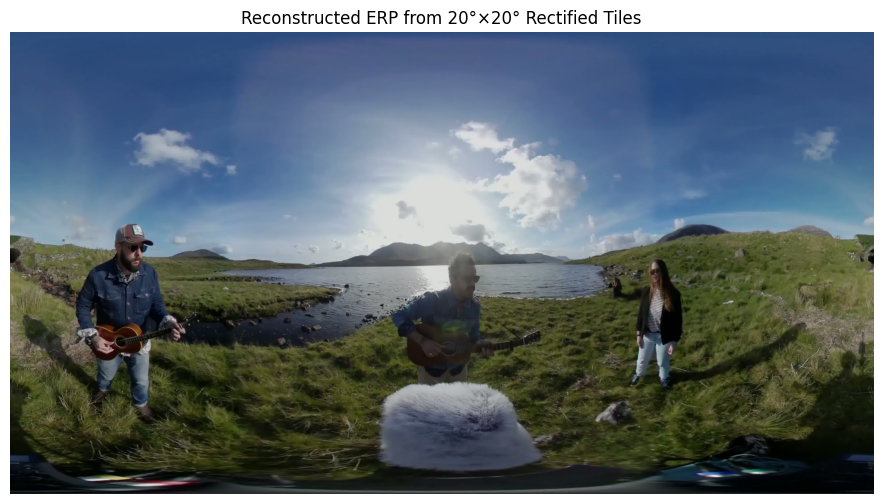

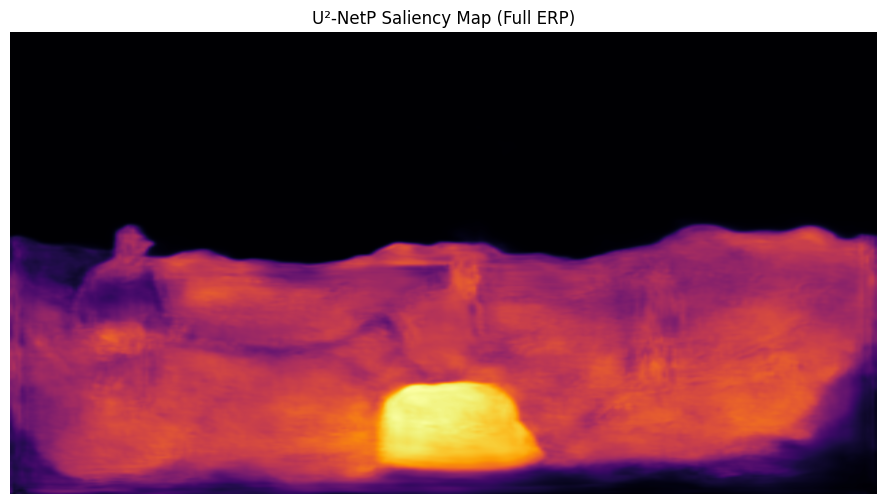


=== Processing frame 22/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0022.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0022.jpg
Height = 2048, Width = 3840


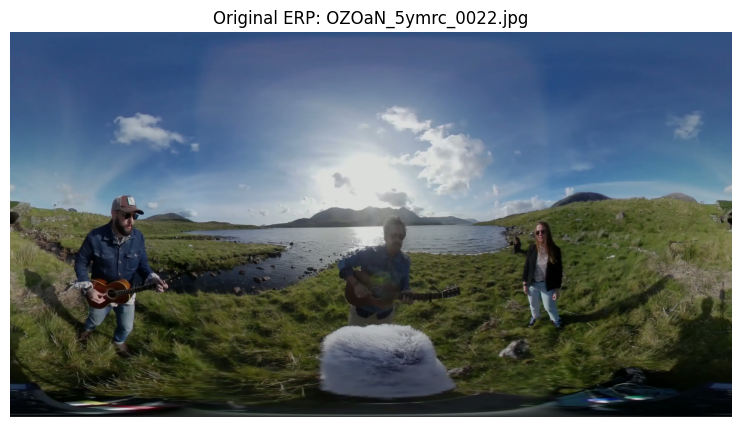

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


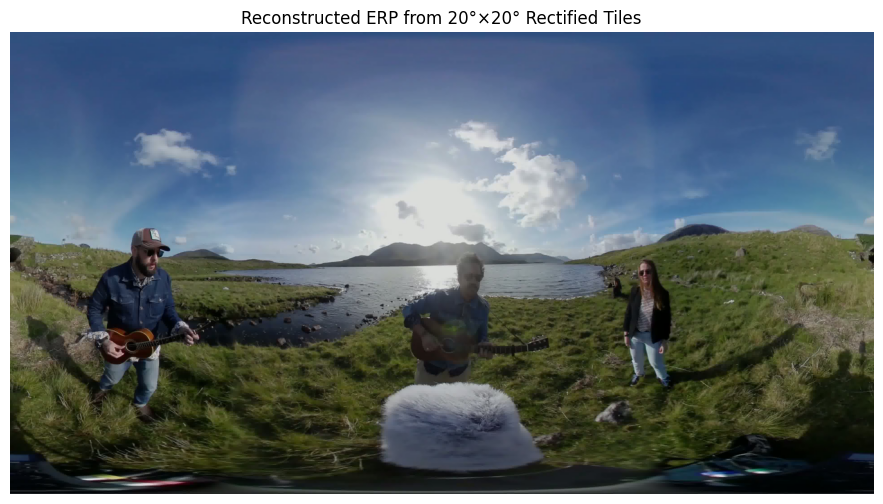

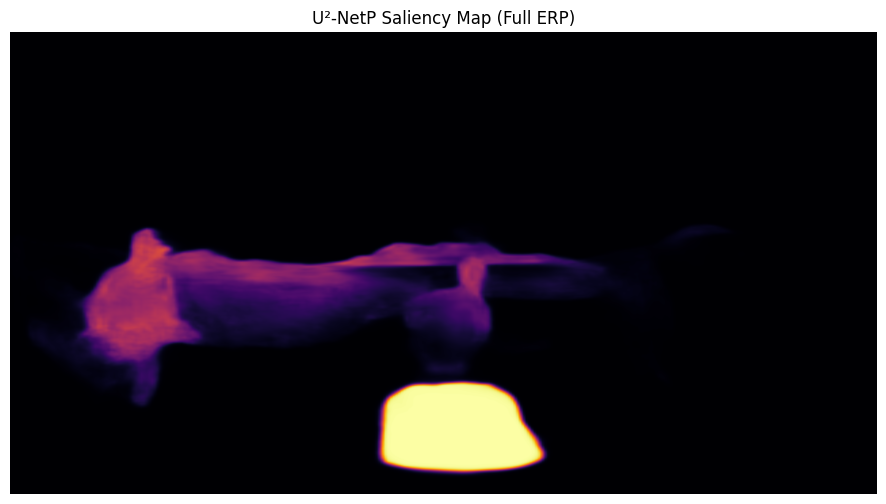


=== Processing frame 23/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0023.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0023.jpg
Height = 2048, Width = 3840


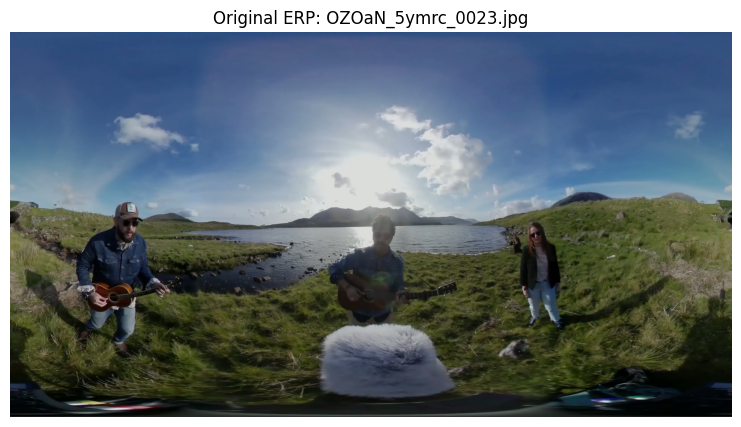

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


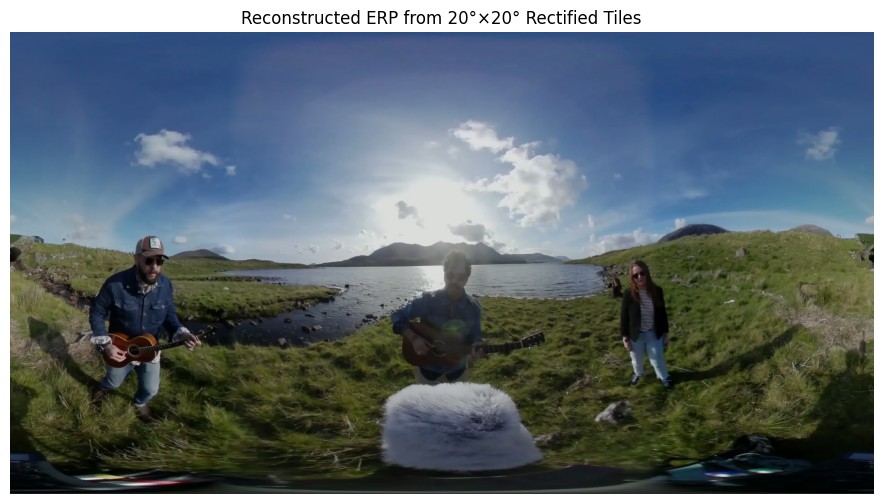

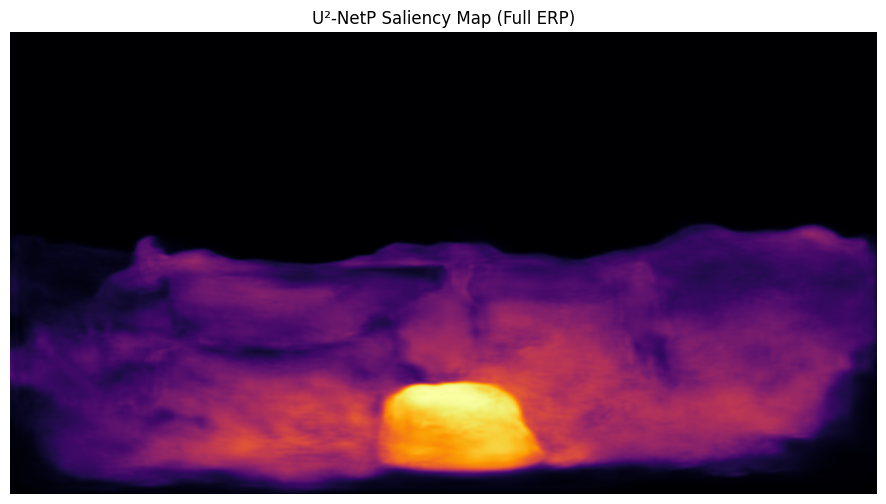


=== Processing frame 24/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0024.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0024.jpg
Height = 2048, Width = 3840


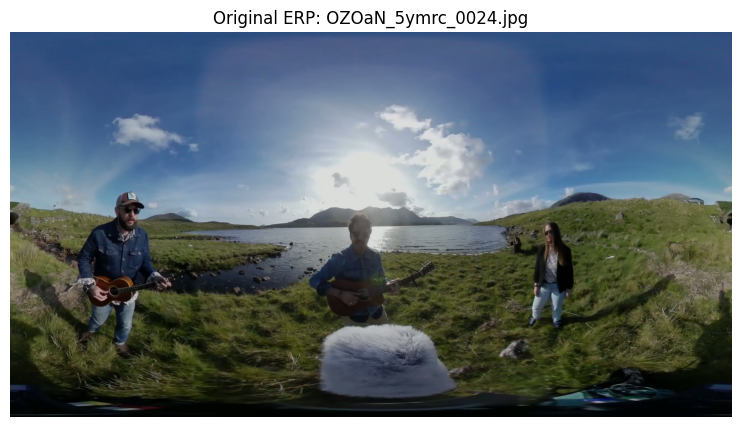

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


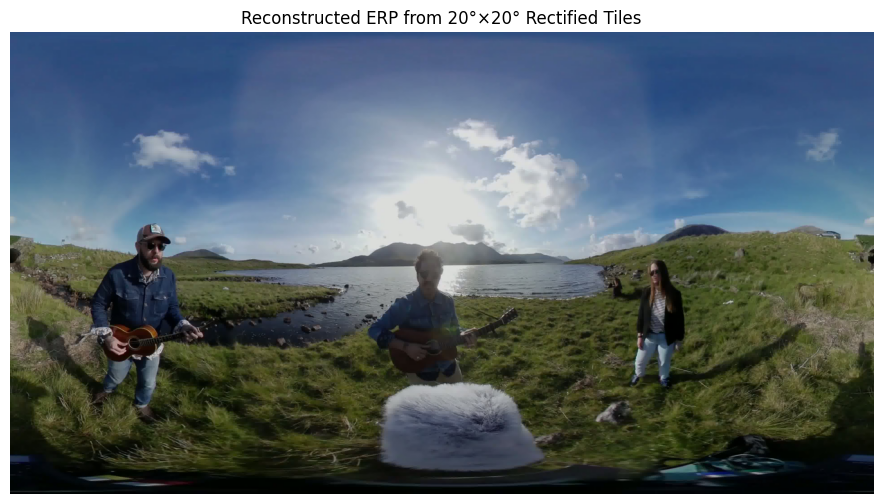

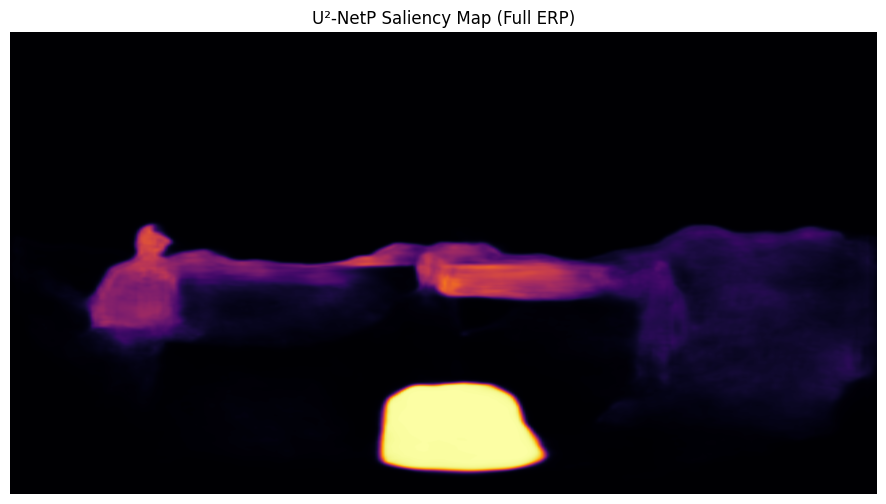


=== Processing frame 25/25: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0025.jpg ===

Processing: /content/frames/OZOaN_5ymrc/OZOaN_5ymrc_0025.jpg
Height = 2048, Width = 3840


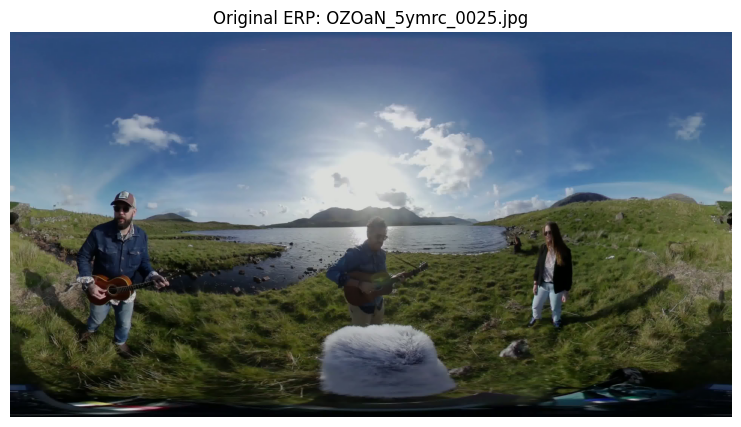

Tile width = 213, Tile height = 228
Reconstructed ERP shape: (2052, 3834, 3)


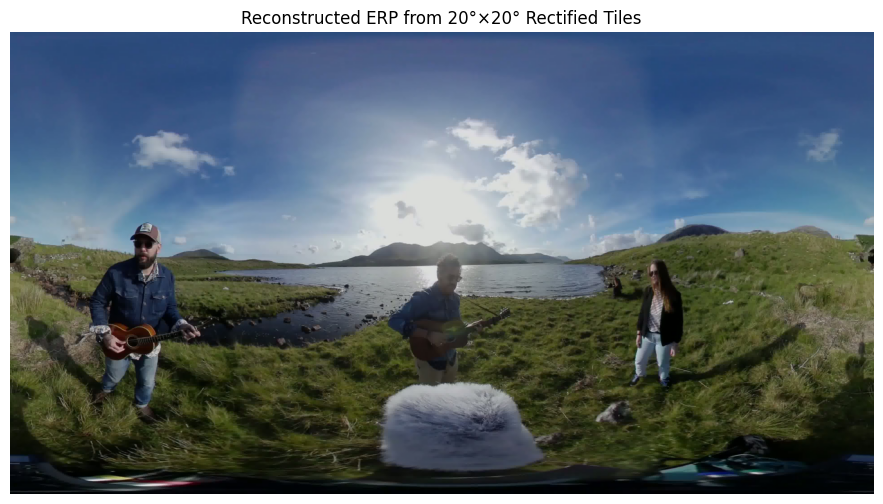

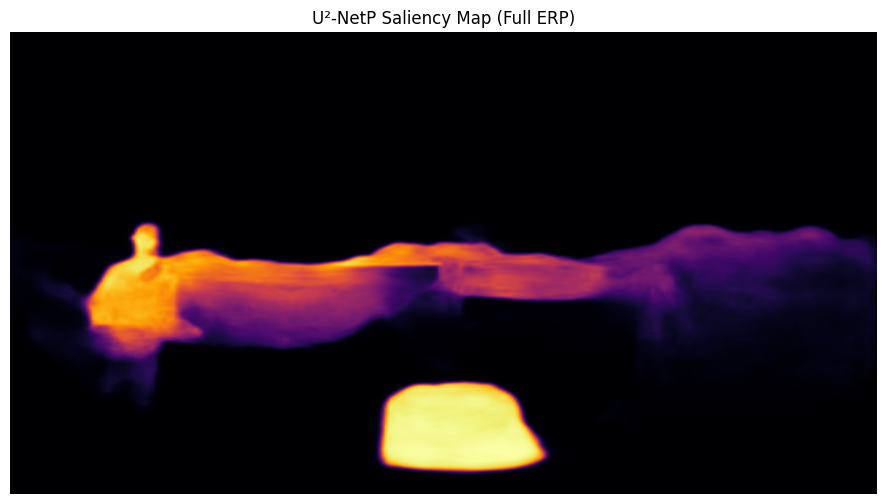

✔ All saliency maps saved to: /content/saliency_frames


In [13]:
# ============================================================
# STEP 0: Load and Sort Frames
# ============================================================
import zipfile
import os

zip_path = "/content/OZOaN_5ymrc_Tiling_Test.zip"
extract_folder = "/content/frames"

# Create folder if it doesn't exist
os.makedirs(extract_folder, exist_ok=True)

# Unzip
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_folder)

print("✔ Frames extracted to:", extract_folder)

# List first 5 files
import glob
frame_files = sorted(glob.glob(os.path.join(extract_folder, "OZOaN_5ymrc", "*.jpg")))
print("Total frames:", len(frame_files))
print("First 5 frames:", frame_files[:5])

# ============================================================
# STEP 1: Run Saliency on each Frame
# ============================================================

import matplotlib.pyplot as plt

# Output folder for saliency maps
saliency_output_folder = "/content/saliency_frames"
os.makedirs(saliency_output_folder, exist_ok=True)

for i, frame_path in enumerate(frame_files):
    print(f"\n=== Processing frame {i+1}/{len(frame_files)}: {frame_path} ===")

    # Run your existing process_image() function
    # Make sure process_image() now returns the saliency map
    saliency_map = process_image(frame_path)

    # Save saliency map as PNG
    save_name = f"sal_{i+1:04d}.png"
    save_path = os.path.join(saliency_output_folder, save_name)
    plt.imsave(save_path, saliency_map, cmap="inferno")

print("✔ All saliency maps saved to:", saliency_output_folder)

In [14]:
# ============================================================
# STEP 2: Saliency Frame into video
# ============================================================

import cv2

saliency_files = sorted(glob.glob(os.path.join(saliency_output_folder, "*.png")))

# Read first frame to get resolution
sample = cv2.imread(saliency_files[0])
h, w, _ = sample.shape

# Video writer
out_video = cv2.VideoWriter("saliency_video.mp4",
                            cv2.VideoWriter_fourcc(*"mp4v"),
                            1,  # 1 FPS (1 frame per second)
                            (w, h))

for f in saliency_files:
    out_video.write(cv2.imread(f))

out_video.release()
print("✔ Saliency video saved as saliency_video.mp4")

✔ Saliency video saved as saliency_video.mp4


In [15]:
# ============================================================
# STEP 3: Download Saliency Video to Local Machine
# ============================================================
from google.colab import files

# Path to the video
video_path = "saliency_video.mp4"

# Trigger download to your local machine
files.download(video_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>